<p style = "background-color : #fca828; border-radius: 5px 5px; padding : 15px"><strong>

# Booking reviews

<p style = "background-color : #fca828; border-radius: 5px 5px; padding : 15px"><strong>


![](https://spahotelsindica.ru/content/img/img_mass/new_img_45_60.jpg)


**Описание проблемы:**
Нечестные отели, которые накручивают себе рейтинг. 

**Решение проблемы:**
Построение модели, которая предсказывает рейтинг отеля. Если предсказания модели сильно отличаются от фактического результата, то, возможно, отель играет нечестно, и его стоит проверить.

**Признаки**:
- <span style="color:#ff1e00">**hotel_address**</span> - адрес отеля
- <span style="color:#ff1e00">**review_date**</span> - дата, когда рецензент разместил соответствующий отзыв.
- <span style="color:#ff1e00">**average_score**</span> - средний балл отеля, рассчитанный на основе последнего комментария за последний год
- <span style="color:#ff1e00">**hotel_name**</span> - название отеля
- <span style="color:#ff1e00">**reviewer_nationality**</span> - национальность рецензента
- <span style="color:#ff1e00">**negative_review**</span> - отрицательный отзыв, который рецензент дал отелю.
- <span style="color:#ff1e00">**review_total_negative_word_counts**</span> - общее количество слов в отрицательном отзыв
- <span style="color:#ff1e00">**positive_review**</span> - положительный отзыв, который рецензент дал отелю
- <span style="color:#ff1e00">**review_total_positive_word_counts**</span> - общее количество слов в положительном отзыве
- <span style="color:#ff1e00">**reviewer_score**</span> - оценка, которую рецензент поставил отелю на основе своего опыта
- <span style="color:#ff1e00">**total_number_of_reviews_reviewer_has_given**</span> - количество отзывов, которые рецензенты дали в прошлом
- <span style="color:#ff1e00">**total_number_of_reviews**</span> - общее количество действительных отзывов об отеле
- <span style="color:#ff1e00">**tags**</span> - теги, которые рецензент дал отелю.
- <span style="color:#ff1e00">**days_since_review**</span> - продолжительность между датой проверки и датой очистки
- <span style="color:#ff1e00">**additional_number_of_scoring**</span> - есть также некоторые гости, которые просто поставили оценку сервису, а не оставили отзыв. Это число указывает, сколько там действительных оценок без проверки.
- <span style="color:#ff1e00">**lat**</span> - широта отеля
- <span style="color:#ff1e00">**lng**</span> - долгота отеля

<p style = "background-color : #fca828; border-radius: 5px 5px; padding : 15px"><strong>

<p style = "background-color : #2724bf; border-radius: 5px 5px; padding : 10px"><strong>

#  Навигация по работе

<p style = "background-color : #2724bf; border-radius: 5px 5px; padding : 10px"><strong>

* <a href ="#1">1. Чтение и предварительный анализ данных</a>
* <a href ="#2">2. Анализ адресов отеля</a>
* <a href ="#3">3. Географические координаты [lat] [lng]</a>
* <a href ="#4">4. Дата и время [review_data]</a>
* <a href ="#5">5. Анализ национальностей [reviewer_nationality]</a>
* <a href ="#6">6. Анализ тегов [tags]</a>
* <a href ="#7">7. Негативные и позитивные отзывы [negative_review, positive_review]</a>
* <a href ="#8">8. Количество слов в отзывах [review_total_negative_word_counts, review_total_positive_word_counts]</a>
* <a href ="#9">9. Название отеля [hotel_name]</a>
* <a href ="#10">10. Остаточные не закодированные признаки</a>
* <a href ="#11">11. Отбор признаков признаков</a>
* <a href ="#12">12. Обучение модели</a>
* <a href ="#13">13. Выводы</a>



<p style = "background-color : #2724bf; border-radius: 5px 5px; padding : 10px"><strong>

<a id='1'></a>
<p style = "background-color : #09fc05; border-radius: 5px 5px; padding : 10px"><strong>

# 1. Чтение и предварительный анализ данных

<p style = "background-color : #09fc05; border-radius: 5px 5px; padding : 10px"><strong>

<p style = "background-color : #59f068; border-radius: 5px 5px; padding : 10px"><strong>
<span style="color:#000">Импортируем библиотеки используемые в работе:</span>

In [10]:
# %capture

# !pip install matplotlib
# !pip install seaborn
# !pip install plotly.express
# !pip install category_encoders
# !pip install scikit-learn
# !pip install termcolor
# !pip install geopy
# !pip install nltk

# Расчёты
import numpy as np
import pandas as pd

# Визуализация
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

# Обучение моделей
from sklearn.ensemble import RandomForestRegressor
from sklearn import metrics

# Математические и регулярные выражения
import math
import re

# Кодирование признаков
import category_encoders as ce

# Нормализация, стандартизация
from sklearn import preprocessing

# Разделение датасета:
from sklearn.model_selection import train_test_split

# Тесты
from sklearn.feature_selection import f_classif # anova
from sklearn.feature_selection import chi2 # хи-квадрат

# Вычисления расстояния между двумя точками
from geopy.distance import geodesic

# Анализа тональности:
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# Подсчет частоты встречаемости элементов
from collections import Counter

# Для распечатки в цвете:
from termcolor import colored

In [11]:
# зафиксируем версию пакетов, чтобы эксперименты были воспроизводимы:
!pip freeze > requirements.txt

In [12]:
# # Выполним чтения датафрейма
# df_bking = pd.read_csv('data\hotels.csv')
# # Выведем первые строки
# df_bking.head(5)

In [13]:
# Фиксируем RANDOM_STATE
RANDOM_STATE = 42

In [14]:
df_train = pd.read_csv('data\hotels_train.csv') # датасет для обучения
df_test = pd.read_csv('data\hotels_test.csv') # датасет для предсказания

# объединяем трейн и тест в один датасет
df_train['sample'] = 1 # помечаем где у нас трейн
df_test['sample'] = 0 # помечаем где у нас тест
df_test['reviewer_score'] = 0 # в тесте у нас нет значения reviewer_score, мы его должны предсказать, по этому пока просто заполняем нулями


# обьединяем датасеты в один, для более удобной работы с одной датасетом, а не двумя.
df_bking = pd.concat([df_train, df_test], ignore_index = True)

df_bking.head(5)


,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,review_total_positive_word_counts,total_number_of_reviews_reviewer_has_given,reviewer_score,tags,days_since_review,lat,lng,sample
0,Stratton Street Mayfair Westminster Borough Lo...,581,2/19/2016,8.4,The May Fair Hotel,United Kingdom,Leaving,3,1994,Staff were amazing,4,7,10.0,"[' Leisure trip ', ' Couple ', ' Studio Suite ...",531 day,51.507894,-0.143671,1
1,130 134 Southampton Row Camden London WC1B 5AF...,299,1/12/2017,8.3,Mercure London Bloomsbury Hotel,United Kingdom,poor breakfast,3,1361,location,2,14,6.3,"[' Business trip ', ' Couple ', ' Standard Dou...",203 day,51.521009,-0.123097,1
2,151 bis Rue de Rennes 6th arr 75006 Paris France,32,10/18/2016,8.9,Legend Saint Germain by Elegancia,China,No kettle in room,6,406,No Positive,0,14,7.5,"[' Leisure trip ', ' Solo traveler ', ' Modern...",289 day,48.845377,2.325643,1
3,216 Avenue Jean Jaures 19th arr 75019 Paris Fr...,34,9/22/2015,7.5,Mercure Paris 19 Philharmonie La Villette,United Kingdom,No Negative,0,607,Friendly staff quiet comfortable room spotles...,11,8,10.0,"[' Leisure trip ', ' Solo traveler ', ' Standa...",681 day,48.888697,2.394540,1
4,Molenwerf 1 1014 AG Amsterdam Netherlands,914,3/5/2016,8.5,Golden Tulip Amsterdam West,Poland,Torn sheets,4,7586,The staff was very friendly and helpful Break...,20,10,9.6,"[' Business trip ', ' Couple ', ' Standard Dou...",516 day,52.385601,4.847060,1


In [131]:
print(colored('Смотрим типы данных и наличие пропусков:\n', 'green'))
df_bking.info()
print(colored(f'\n- Количество столбцов:{df_bking.shape[1]}','green'))
print(colored(f'- Количество строк: {df_bking.shape[0]}','green'))
print(colored(f'- Количество дубликатов: {df_bking[df_bking.duplicated()].shape[0]}','green'))

Смотрим типы данных и наличие пропусков:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 515738 entries, 0 to 515737
Data columns (total 74 columns):
 #   Column                                      Non-Null Count   Dtype         
---  ------                                      --------------   -----         
 0   hotel_address                               515738 non-null  object        
 1   additional_number_of_scoring                515738 non-null  float64       
 2   review_date                                 515738 non-null  datetime64[ns]
 3   average_score                               515738 non-null  float64       
 4   hotel_name                                  515738 non-null  int16         
 5   negative_review                             515738 non-null  object        
 6   review_total_negative_word_counts           515738 non-null  int64         
 7   total_number_of_reviews                     515738 non-null  float64       
 8   positive_review                 

TypeError: unhashable type: 'dict'

<p style = "background-color : #59f068; border-radius: 5px 5px; padding : 10px"><strong>
<span style="color:#000">Визуализируем пропуска на графике:</span>

<Axes: >

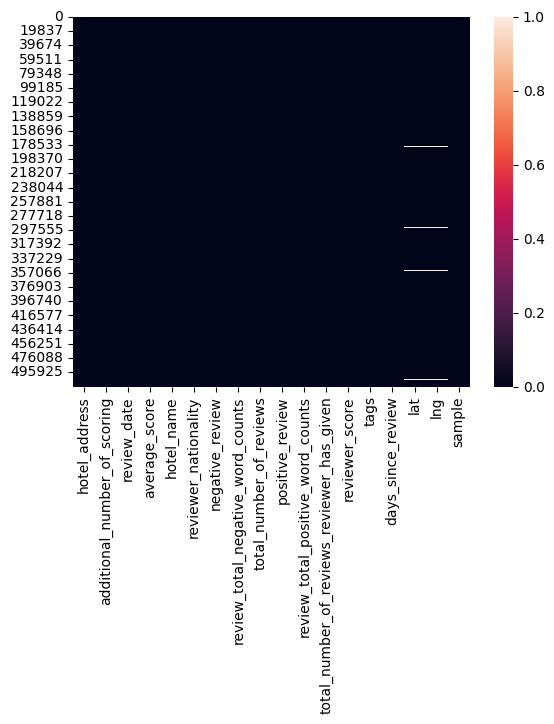

In [16]:
sns.heatmap(df_bking.isnull())

Действительно, в колонках **lat** и **lng** присутствуют пропуска.
При этом видно, что пропуска находятся в одних и тех же строчках.

В будущем мы удалим дубликаты и заполним пустые строки. 

<p style = "background-color : #95f59ff2; border-radius: 5px 5px; padding : 10px"><strong>
<span style="color:#000">Для работы с данными подготовил функции, которые буду использовать часто:</span>

In [17]:
def build_graph(library, chart_type, data_frame, x, y, height, width, title, xaxis_title, yaxis_title, legend = None, color = None):
    """Функция по построению графиков

    Args:
        library: Библиотека построения
        chart_type: Тип графика
        data_frame: Датафрейм из которого будет читаться данные
        x: Ось x
        y: Ось y
        height: Высота графика
        width: Ширина графика
        title: Название графика
        xaxis_title: Название оси x
        yaxis_title: Название оси y
        legend: Название легенды
        color: Цвет колонок
    Raises:
        ValueError: Ошибка вызова графика
    """
    if library == 'plt':
        plt.figure(figsize=(height, width))
        plt.title(title)
        if chart_type == 'box':
            sns.boxplot(data=data_frame, x=x, y=y)
        elif chart_type == 'bar':
            sns.barplot(data=data_frame, x=x, y=y)
        else:
            raise ValueError("Неподдерживаемый тип графика. Допустимые значения chart_type: 'box', 'bar'")
        plt.xlabel(xaxis_title)
        plt.ylabel(yaxis_title)
        plt.show()
    # Вдруг kaggle одумается и отобразит графики plotly
    elif library == 'px':
        if chart_type == 'box':
            fig = px.box(data_frame=data_frame, x=x, y=y, color=color)
        elif chart_type == 'bar':
            fig = px.bar(data_frame=data_frame, x=x, y=y, color=color)
        else:
            raise ValueError("Неподдерживаемый тип графика. Допустимые значения chart_type: 'box', 'bar'")
        
        fig.update_layout(
            title=dict(x=0.5, xanchor="center"),
            legend_title=legend,
            xaxis_title=xaxis_title,
            yaxis_title=yaxis_title,
            margin=dict(l=0, r=0, t=30, b=0),
            title_x=0.5
        )
        fig.show()
    else:
        raise ValueError("Неподдерживаемая библиотека. Допустимые значения library: 'px', 'plt'")


In [18]:
# Построение корреляционных графиков
def build_corr(df, columns, title, method):
    """Функция по построению графиков

    Args:
        df: датасет
        columns: Название колонок
        title: Название графика
        method: _description_
    """    
    fig_, ax_ = plt.subplots(figsize=(20, 15))
    corr = df[columns].corr(method=method).abs()
    mask = np.triu(np.ones_like(corr, dtype=bool))
    sns.heatmap(corr, 
                annot=True,
                annot_kws={"fontsize":9}, 
                linewidths=0.1, 
                ax=ax_, 
                mask=mask, 
                cmap='Pastel1_r',
                fmt='.2f')
    ax_.set_title(title, fontsize=18)
    plt.show()

In [19]:
#  Просмотр признаков
def see_row(name_row):
    """Функция для удобства чтения признаков
    Args:
        name_row (_str_): Название колонки
    """    
    for row in df_bking[name_row].head(20):
        print(row)

In [20]:
# Функция кодирования Ordinal Encoding колонок:
def ordinal_column(df, row, new_row, size_list):
    """Порядковое кодирование колонок

    Args:
        df: датасет
        row: Колонка, из которой берётся информация
        new_row: Колонка которая будет создана
        size_list: словарь с описанием кодировки
    """    
    ord_encoder = ce.OrdinalEncoder(mapping=[{
        'col': row,
        'mapping': size_list
    }])
    
    # Создание новой закодированной колонки
    df[new_row] = ord_encoder.fit_transform(df[[row]])
    df.drop([row], axis=1, inplace=True) 

In [21]:
# Функция кодирования OneHot Encoding колонок:
def onehot_column(df, row):
    """Однократное кодирование

    Args:
        df (_type_): датасет
        row (_type_): Редактируемая колонка
        
    """    
    encoder = ce.OneHotEncoder(cols=[row])
    type_bin = encoder.fit_transform(df[row])
    df = pd.concat([df, type_bin], axis=1)
    df.drop([row], axis=1, inplace=True)
    return df 

In [22]:
# Функция кодирования Binary Encoding колонок:
def binary_column(df, row):
    """Бинарное кодирование

    Args:
        df (_type_): датасет
        row (_type_): Редактируемая колонка
    """    
    bit_encoder = ce.BinaryEncoder(cols=[row])
    type_bin = bit_encoder.fit_transform(df[row])
    df = pd.concat([df, type_bin], axis=1)
    df.drop([row], axis=1, inplace=True)
    return df

<p style = "background-color : #95f59ff2; border-radius: 5px 5px; padding : 10px"><strong>
<span style="color:#000">Для удобства создадим словарь с функциями, чтобы упростить подбор необходимых функций:</span>

In [23]:
def_dict = {'Построение графиков':'build_graph',
            'Построение корреляционных графиков': 'build_corr',
            'Просмотр признаков': 'see_row',
            'Ordinal Encoding' :'ordinal_column',
            'OneHot Encoding': 'onehot_column',
            'Binary Encoding': 'binary_column'}

При создании данного словаря, появилась идея сделать собственный набор функций отдельным файлом, чтобы каждый раз его не писать при изучении датасета.
Потом просто будем выводить информацию о всех функциях, выбирать и применять в работе.

<p style = "background-color : #95f59ff2; border-radius: 5px 5px; padding : 10px"><strong>
<span style="color:#000"> Создадим drop_list, куда соберем остаточные колонки, которые необходимо будет удалять по окончанию анализа:</span>

In [24]:
drop_list = []

***Отсылка к читающим этот файл:***

> Была идея вывести все функции по работе в данный раздел, но всё же решил оставить их на месте с навигацей по документу. Но пока что слабо владею визуализацией оформления работ в markdown и HTML, ну и возможностями навигации в том числе. Будет круто если кто-то комментариях при просмотре или проверки работы укажут ссылки или видеоматериалы для крутых оформлений документов ipynb, чтобы изучить и поднять на уровень свои навыки

<p style = "background-color : #09fc05; border-radius: 5px 5px; padding : 10px"><strong>

<a id='2'></a>
<p style = "background-color : #dbfc00; border-radius: 5px 5px; padding : 10px"><strong>

# 2. Анализ адресов отеля [hotel_address]

<p style = "background-color : #dbfc00; border-radius: 5px 5px; padding : 10px"><strong>

Рассмотри, что из себя представляет данный признак:

In [25]:
see_row('hotel_address')

Stratton Street Mayfair Westminster Borough London W1J 8LT United Kingdom
130 134 Southampton Row Camden London WC1B 5AF United Kingdom
151 bis Rue de Rennes 6th arr 75006 Paris France
216 Avenue Jean Jaures 19th arr 75019 Paris France
Molenwerf 1 1014 AG Amsterdam Netherlands
Via Mecenate 121 20138 Milan Italy
97 Cromwell Road Kensington and Chelsea London SW7 4DN United Kingdom
Josefsgasse 4 6 08 Josefstadt 1080 Vienna Austria
190 Queen s Gate Kensington and Chelsea London SW7 5EX United Kingdom
Holland Park Avenue Kensington and Chelsea London W11 4UL United Kingdom
Molenwerf 1 1014 AG Amsterdam Netherlands
34 44 Barkston Gardens Kensington and Chelsea London SW5 0EW United Kingdom
16 Sumner Place Kensington and Chelsea London SW7 3EG United Kingdom
97 Cromwell Road Kensington and Chelsea London SW7 4DN United Kingdom
Putget 68 Sarri St Gervasi 08023 Barcelona Spain
Caspe 103 Eixample 08013 Barcelona Spain
1 Kings Cross Road Islington London WC1X 9HX United Kingdom
Wrights Lane Kens

Признак **hotel_address** несёт под собой следующую информацию (*Слева направо*):

- **Улицу**;
- **Район расположения**;
- **Индекс**;
- **Город расположения**;
- **Страна**.

Не много структурируем и вытащим полезную для нас полезную информацию для анализа 

In [26]:
# Вытащим информацию по странам, с последующем созданием новых признаков
df_bking['hotel_country'] = df_bking['hotel_address'].apply(lambda x: x.split()[-1])
# Видим одну страну состоящую из двух слов, поэтому восстановим её название
df_bking['hotel_country'] = df_bking['hotel_country'].replace('Kingdom', 'United Kingdom')

# Выпишем выдержку
country = df_bking['hotel_country'].value_counts()
print(colored(f'Страны в которых расположены отели:\n{country}', 'yellow'))

Страны в которых расположены отели:
United Kingdom    262301
Spain              60149
France             59928
Netherlands        57214
Austria            38939
Italy              37207
Name: hotel_country, dtype: int64


Итак у нас есть 6 стран в данном датасете.
 
Определимся теперь с городами, которые у нас присутствуют в каждой стране

In [27]:
# Информация по городам:
df_bking['hotel_city'] = df_bking['hotel_address'].apply\
    (lambda x: x.split()[-5] if x.split()[-1] == 'Kingdom' else x.split()[-2])


town = df_bking['hotel_city'].value_counts()
print(colored(f'Города расположения отелей:\n{town}', 'yellow'))


Города расположения отелей:
London       262301
Barcelona     60149
Paris         59928
Amsterdam     57214
Vienna        38939
Milan         37207
Name: hotel_city, dtype: int64


По сути, мы мы получим два новых признака: Страна 'hotel_country' и Город  'hotel_city', но исходя из их названий и количества вхождений видно, что страна равна городу. Направшивается вопрос, а зачем нам дублирование признаков? Но на данный момент оставим этот признак, может быть где-то что-то и понадобиться. Поэтому чуть позже доберемся до очистки.

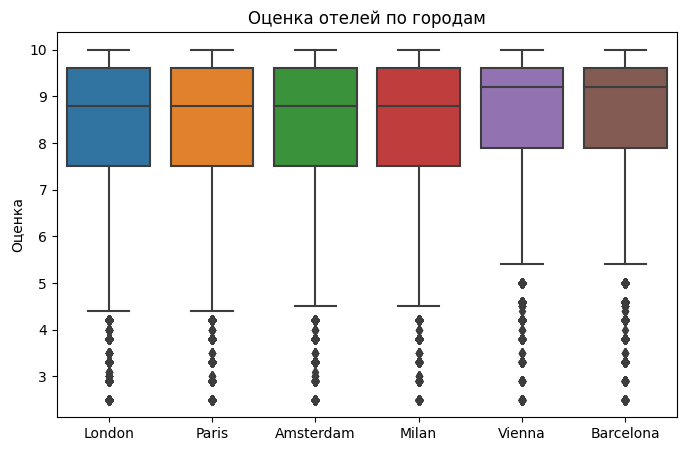

In [28]:
# build_graph('px', 'box', df_bking[df_bking['sample'] == 1], 'hotel_city', 'reviewer_score', 8, 5, 'Оценка отелей по городам', '', 'Оценка', color='hotel_city')
build_graph('plt', 'box', df_bking[df_bking['sample'] == 1], 'hotel_city', 'reviewer_score', 8, 5, 'Оценка отелей по городам', '', 'Оценка')

Визуализация нам показа, что в Лондоне, Париже, Амстердаме и Милане оценки практически совпадают, но в Вене и Барселоне выше. Данный признак имеет место быть при построении модели.

Теперь взглянем на районы исходя из почтовых признаков. 
Необходимо учесть, исходя из рассмотренного признака, что для Амстердама и Лондона признак находится на 4 месте, а у остальных на 3. Отчет признака начинается с хвоста.

In [29]:
# создадим функцию по перебору данных:
def index_city(row):
    """Преобразовываем из hotel_address колонку с районами

    Args:
        Строка с адресом, страной, индексом, городом (_type_): Строка с районом
    """    
    if (row['hotel_city'] == 'Amsterdam') or (row['hotel_city'] == 'London'):
        return row['hotel_address'].split()[-4]
    else:
        return row['hotel_address'].split()[-3]

# Притеним созданную функцию:
df_bking['hotel_district'] = df_bking[['hotel_address', 'hotel_city',]].apply(index_city, axis=1)

# Взглянем, что у нас выходит:
df_bking['hotel_district'].value_counts()

W2       33155
SE1      17898
SW7      15374
1012     13209
1010     12440
         ...  
20142       33
WC2E        27
20141       22
1230        21
92120       10
Name: hotel_district, Length: 239, dtype: int64

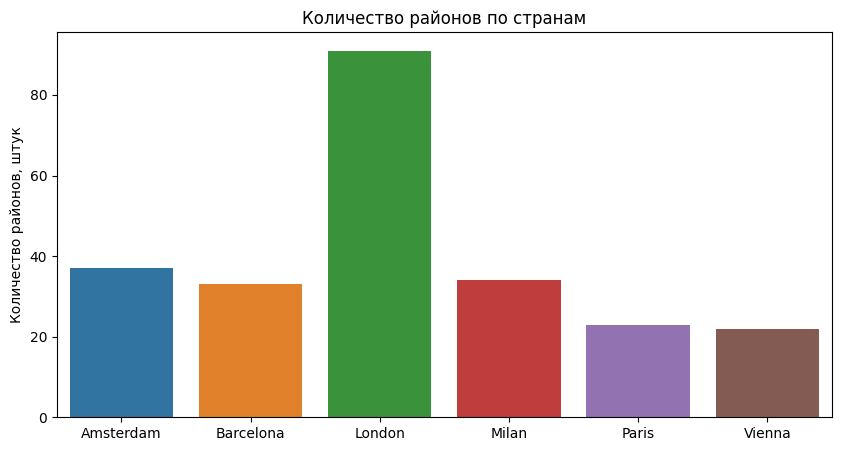

In [30]:
# группируем города по районам:
count_by_country = df_bking.groupby('hotel_city')['hotel_district'].nunique().reset_index()
# выполняем построение:
build_graph('plt', 'bar', count_by_country, 'hotel_city', 'hotel_district', 10, 5, 'Количество районов по странам', '', 'Количество районов, штук')
# build_graph('px', 'bar', count_by_country, 'hotel_city', 'hotel_district', 10, 5, 'Количество районов по странам', '', 'Количество районов, штук', color='hotel_city')

Больше всего районов охваченными отелями в Лондоне. Взглянем, как изменяется оценка по городам в зависимости от района. Но для этого построения будем использовать `matplotlib.pyplot`, так как в `plotly.express` от такого большого количества значений идет сильная нагрузка на ноутбук и приходится очень долго прогружать, чтобы получить данные. 

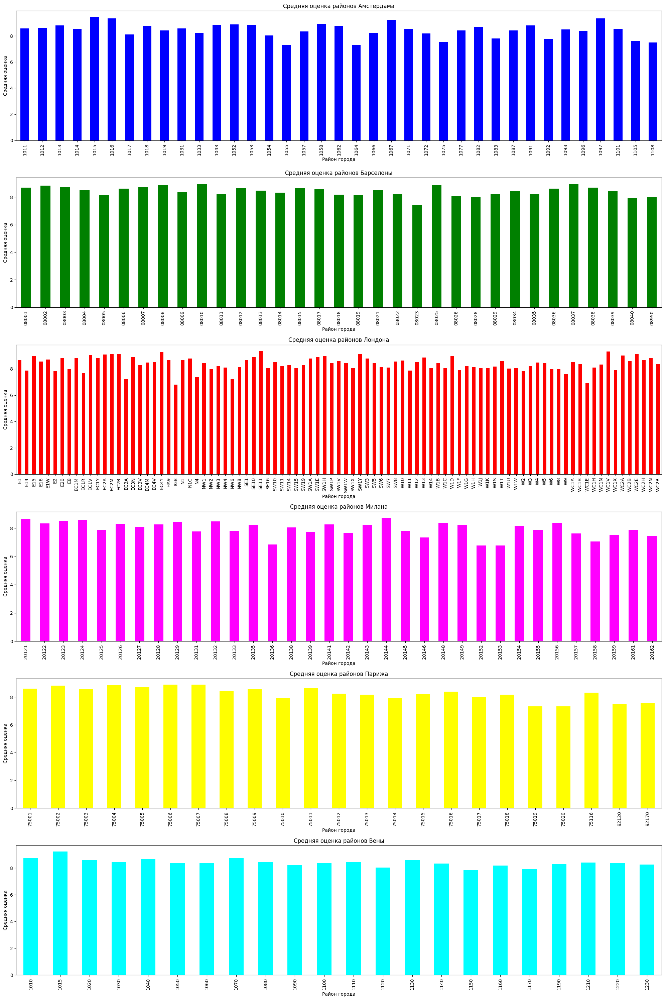

In [31]:
# Для удобства построения, создадим временные таблицы с фильтрами по городам:
df_amsterdam = df_bking[df_bking['hotel_city'] == 'Amsterdam']
df_barcelona = df_bking[df_bking['hotel_city'] == 'Barcelona']
df_london = df_bking[df_bking['hotel_city'] == 'London']
df_milan = df_bking[df_bking['hotel_city'] == 'Milan']
df_paris = df_bking[df_bking['hotel_city'] == 'Paris']
df_vienna = df_bking[df_bking['hotel_city'] == 'Vienna']


# Создадим 6 фигур
fig, axes = plt.subplots(nrows=6, ncols=1, figsize=(20, 30))


# Создание первого графика
df_amsterdam[df_amsterdam['sample']==1].groupby('hotel_district')['reviewer_score'].mean().plot(kind='bar', ax=axes[0], color='blue')
axes[0].set_title('Средняя оценка районов Амстердама')
axes[0].set_xlabel('Район города')
axes[0].set_ylabel('Средняя оценка')


# Создание второго графика
df_barcelona[df_barcelona['sample']==1].groupby('hotel_district')['reviewer_score'].mean().plot(kind='bar', ax=axes[1], color='green')
axes[1].set_title('Средняя оценка районов Барселоны')
axes[1].set_xlabel('Район города')
axes[1].set_ylabel('Средняя оценка')

# Создание третьего графика
df_london[df_london['sample']==1].groupby('hotel_district')['reviewer_score'].mean().plot(kind='bar', ax=axes[2], color='red')
axes[2].set_title('Средняя оценка районов Лондона')
axes[2].set_xlabel('Район города')
axes[2].set_ylabel('Средняя оценка')

# Создание четвертого графика
df_milan[df_milan['sample']==1].groupby('hotel_district')['reviewer_score'].mean().plot(kind='bar', ax=axes[3], color='magenta')
axes[3].set_title('Средняя оценка районов Милана')
axes[3].set_xlabel('Район города')
axes[3].set_ylabel('Средняя оценка')

# Создание пятого графика
df_paris[df_paris['sample']==1].groupby('hotel_district')['reviewer_score'].mean().plot(kind='bar', ax=axes[4], color='yellow')
axes[4].set_title('Средняя оценка районов Парижа')
axes[4].set_xlabel('Район города')
axes[4].set_ylabel('Средняя оценка')

# Создание шестого графика
df_vienna[df_vienna['sample']==1].groupby('hotel_district')['reviewer_score'].mean().plot(kind='bar', ax=axes[5], color='cyan')
axes[5].set_title('Средняя оценка районов Вены')
axes[5].set_xlabel('Район города')
axes[5].set_ylabel('Средняя оценка')


plt.tight_layout()  # Расположение графиков в окне
plt.show()


Визуализация показывает, что оценки изменяются в зависимости от района. Этот параметр будет интересен при машинном обучении.
Данные признаки пока не будем подвергать кодированию и удалению, они могут нам пригодиться в дальнешем изучении.

In [32]:
# Убираем дублирующий и переработанный признак в копилочку
drop_list.extend(['hotel_address', 'hotel_country'])

<p style = "background-color : #dbfc00; border-radius: 5px 5px; padding : 10px"><strong>

<a id='3'></a>
<p style = "background-color : #00dffc; border-radius: 5px 5px; padding : 10px"><strong>

# 3. Географические координаты [lat] [lng]

<p style = "background-color : #00dffc; border-radius: 5px 5px; padding : 10px"><strong>

Ранее мы определили, что признаки **lat** и **lnd** имееют пропуски. Рассмотрим пропуски и их количество 

In [33]:
# Сгрупируем по отелям и посмотрим у каких отелей отсутствуют геоданные
hotels_nan = df_bking[df_bking.lng.isna() & df_bking.lat.isna()].groupby(by = ['hotel_address','hotel_name']).\
  count().iloc[:,0].to_frame().reset_index()
hotels_nan


,hotel_address,hotel_name,additional_number_of_scoring
0,20 Rue De La Ga t 14th arr 75014 Paris France,Mercure Paris Gare Montparnasse,37
1,23 Rue Damr mont 18th arr 75018 Paris France,Holiday Inn Paris Montmartre,55
2,4 rue de la P pini re 8th arr 75008 Paris France,Maison Albar Hotel Paris Op ra Diamond,290
3,Bail n 4 6 Eixample 08010 Barcelona Spain,NH Collection Barcelona Podium,146
4,Gr nentorgasse 30 09 Alsergrund 1090 Vienna Au...,City Hotel Deutschmeister,93
5,Hasenauerstra e 12 19 D bling 1190 Vienna Austria,Hotel Park Villa,61
6,Josefst dter Stra e 10 12 08 Josefstadt 1080 V...,Fleming s Selection Hotel Wien City,658
7,Josefst dter Stra e 22 08 Josefstadt 1080 Vien...,Cordial Theaterhotel Wien,57
8,Landstra er G rtel 5 03 Landstra e 1030 Vienna...,Hotel Daniel Vienna,245
9,Paragonstra e 1 11 Simmering 1110 Vienna Austria,Roomz Vienna,49


Не так уж и много пропусков, как могло бы показаться изначально, поэтому предлагается восстановить расположения в ручную.

Геоданные определим при помощи [google maps](https://www.google.com/maps)

In [34]:
hotels_nan[['lat','lng']] = 0
hotels_nan.loc[0,['lat','lng']] = ['48.84008','2.32355']
hotels_nan.loc[1,['lat','lng']] = ['48.88906','2.33309']
hotels_nan.loc[2,['lat','lng']] = ['48.87547','2.32341']
hotels_nan.loc[3,['lat','lng']] = ['41.39178','2.17790']
hotels_nan.loc[4,['lat','lng']] = ['48.22110','16.36657']
hotels_nan.loc[5,['lat','lng']] = ['48.29599','16.37811']
hotels_nan.loc[6,['lat','lng']] = ['48.20954','16.35342']
hotels_nan.loc[7,['lat','lng']] = ['48.20966','16.35142']
hotels_nan.loc[8,['lat','lng']] = ['48.18896','16.38388']
hotels_nan.loc[9,['lat','lng']] = ['48.22290','16.39346']
hotels_nan.loc[10,['lat','lng']] = ['41.39281','2.16741']
hotels_nan.loc[11,['lat','lng']] = ['48.21967','16.28562']
hotels_nan.loc[12,['lat','lng']] = ['41.38342','2.16299']
hotels_nan.loc[13,['lat','lng']] = ['48.24615','16.34120']
hotels_nan.loc[14,['lat','lng']] = ['48.21369','16.37987']
hotels_nan.loc[15,['lat','lng']] = ['48.21694','16.35993']
hotels_nan.loc[16,['lat','lng']] = ['48.22060','16.35575']

# установим адрес как индекс
hotels_nan.set_index('hotel_address', inplace=True)

# проверим, что выходит
hotels_nan.head(2)

,hotel_name,additional_number_of_scoring,lat,lng
hotel_address,,,,
20 Rue De La Ga t 14th arr 75014 Paris France,Mercure Paris Gare Montparnasse,37,48.84008,2.32355
23 Rue Damr mont 18th arr 75018 Paris France,Holiday Inn Paris Montmartre,55,48.88906,2.33309


В процессе выставление геоданных, выявленно, что в данных не читаются символы отличные от латиницы, и в некоторых улицах и названиях отелях отсутствуют символы, и они могут быть не верны прочитаны пользователем, если захочет узнать информацию об отеле, некоторые места гугл вообще не выдает, и приходилось искать в сети точный адрес и название отеля.

Так как названий улиц очень много, и перебирать их не хочется и заниматься переименованием, оставим их как есть, особо они сильно не пригодятся, а в названиях отеля, который был выявлен в процессе выставления широты и долготы, пожалуй переименуем, капля в бочке, но не хочу оставлять этот моментик.

In [35]:
# Переименуем название отеля
hotels_nan['hotel_name'] = hotels_nan['hotel_name'].replace('Maison Albar Hotel Paris Op ra Diamond', 'Maison Albar Hotel Paris Opera Diamond')

In [36]:
# Напишем небольшую функцию, для заполнения пропусков в геоданных
def add_missing_coors(address, data_dict):
  """
  Входной параметр: адрес, используется для поиска lng, lat в поданном вторым аргументов dataframe.
  Адрес в dataframe является индеком

  Args:
      address (str): строка с адресом отеля
      data_dict (pd.Dataframe()): Dataframe с lng, lat в качестве признаков и адресом в качестве индекса

  Returns:
      pd.Series(): возвращает lng, ltd
  """
  if address in data_dict.index:
    return pd.Series([data_dict.loc[address].lat, data_dict.loc[address].lng],
                     index = ['lat','lng'])

In [37]:
# Работаем только с записями, у которых в наличие пропуски по геоданным, и заполняем пропуски данными в 
# соотвествии с указанными выше геокоординатами
df_bking.loc[df_bking[(df_bking.lat.isna() | df_bking.lng.isna())].index,['lat','lng']] = \
df_bking[df_bking.lat.isna() | df_bking.lng.isna()].loc[:].\
  apply(lambda x: add_missing_coors(x.hotel_address, hotels_nan), axis = 1)


In [38]:
# проверка, что у нас выходит:
df_bking.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 515738 entries, 0 to 515737
Data columns (total 21 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   hotel_address                               515738 non-null  object 
 1   additional_number_of_scoring                515738 non-null  int64  
 2   review_date                                 515738 non-null  object 
 3   average_score                               515738 non-null  float64
 4   hotel_name                                  515738 non-null  object 
 5   reviewer_nationality                        515738 non-null  object 
 6   negative_review                             515738 non-null  object 
 7   review_total_negative_word_counts           515738 non-null  int64  
 8   total_number_of_reviews                     515738 non-null  int64  
 9   positive_review                             515738 non-null  object 
 

Отлино, данные заполненны. Преобразуем в числовой вид геоданные, и визуализируем всё это дело и посмотрим, как работают наши признаки:

In [39]:
# Преобразуем значения столбцов 'lat' и 'lng' в числовой тип данных
df_bking['lat'] = pd.to_numeric(df_bking['lat'])
df_bking['lng'] = pd.to_numeric(df_bking['lng'])

# Создадим график на карте мира с помощью функции `scatter_mapbox` из библиотеки Plotly Express
fig = px.scatter_mapbox(data_frame=df_bking, lat='lat', lon='lng', zoom=1)

# Установим тип карты на 'open-street-map' и ограничем область карты только Евросоюзом
fig.update_layout(
    mapbox_style='open-street-map',
    width = 1000,
    height = 800,
    mapbox=dict(
        center=dict(lat=50, lon=10),
        zoom=3,
        domain=dict(x=[0, 1], y=[0, 1])
    ),
    margin=dict(l=0, r=0, t=0, b=0)  # Убираем белые полосы по бокам
)

# Строим
fig.show()

В мыслях о том, как можно использовать эти данные, пришла идея о привязки их к определенным значимым местам, каким-то популярным достопримечательностям или от центра города. Можно создать много разных зависимостей, к примеру возьмем париж, и расстояние отеля от Эйфелевой башни как складывается цена, но это будет только интересно для парижа. Можно выделить главные достопримечательности по городам. А можно просто взять точку центра города(столицы) до отеля и в зависимости от отдалённости точек посмотреть как влияет на оценку отеля.

Создадим новых два признака lat_capital и lng_capital определим их [координаты](https://time-in.ru/coordinates/), а после вычислим расстояние

In [40]:
def get_lat(country):
    """Создаем Широту города

    Args:
        город
    Return:
        широта
    """
    if country == 'London':
        return 51.50735
    elif country == 'Barcelona':
        return 41.3888
    elif country == 'Paris':
        return 48.85661
    elif country == 'Amsterdam':
        return 52.374
    elif country == 'Vienna':
        return 48.2085
    else:
        return 45.4643


def get_lng(country):
    """Создаем долготу города

    Args:
        Город
    Return:
        долгота
    """
    if country == 'London':
        return -0.12776
    elif country == 'Barcelona':
        return 2.15899
    elif country == 'Paris':
        return 2.35222
    elif country == 'Amsterdam':
        return 4.88969
    elif country == 'Vienna':
        return 16.3721
    else:
        return 9.18951

# Создаем столбик с широтой
df_bking['lat_capital'] = df_bking['hotel_city'].apply(get_lat)
# Создаем столбик с долготой
df_bking['lng_capital'] = df_bking['hotel_city'].apply(get_lng)

# Проверяем, что на выходе
df_bking[['hotel_city', 'lat_capital', 'lng_capital']].value_counts()


hotel_city  lat_capital  lng_capital
London      51.50735     -0.12776       262301
Barcelona   41.38880      2.15899        60149
Paris       48.85661      2.35222        59928
Amsterdam   52.37400      4.88969        57214
Vienna      48.20850      16.37210       38939
Milan       45.46430      9.18951        37207
dtype: int64

Вроде похоже на правду, а теперь попробуем всё это дело высчитать:

In [41]:
# функция для вычисления расстояния между двумя координатами
def calculate_distance(row):
    """Определение расстояние между координатами

    Args:
        row: Координаты отелей

    Returns: Расстояние между центром города и отелем
    """    
    address_coords = (row['lat'], row['lng'])
    city_coords = (row['lat_capital'], row['lng_capital'])
    distance = geodesic(address_coords, city_coords).km
    return round(distance, 3) # округлим до метра

# Применим функцию calculate_distance к каждой строке DataFrame и создадим новый столбец 'distance'
df_bking['from_center'] = df_bking.apply(calculate_distance, axis=1)

# Выглядываем на результат расчета:
df_bking['from_center']

0         1.106
1         1.554
2         2.316
3         4.730
4         3.177
          ...  
515733    4.936
515734    2.025
515735    1.709
515736    1.464
515737    1.787
Name: from_center, Length: 515738, dtype: float64

Отлично, теперь мы можем сделать зависимость рейтинга отеля от удаленности от центра города.

Визуализируем это на тепловой диаграмме, и взглянем как это работает:

In [42]:
# Создаем сводную таблицу:
head_df = df_bking.pivot_table(
    index = "hotel_city",
    columns = "average_score",
    values = "from_center",
    fill_value= 0
)

# Строим тепловую диаграмму:
fig = px.imshow(
    head_df,
    aspect = 'auto',
    color_continuous_scale = 'Reds',
    title = 'Медианные значения оценки отеля в зависимости от расстояния до центра города',
    width = 1200,
    height = 700
)

# Поднастройка легенды:
fig.update_coloraxes(
    colorbar_title_text = 'Расстояние отеля от центра города, км',
    colorbar_title_side = 'right'
)

# Информация при наведении курсора:
fig.update_traces(
    hoverinfo="all",
    hovertemplate="Оценка: %{x}<br>Город: %{y}<br>Расстояние: %{z:,.2f} км")

# Поднастройка осей:
fig.update_layout(
    title = dict(x = .5, xanchor = 'center'),
    xaxis_title = 'Средняя оценка отеля',
    yaxis_title = 'Город',
    yaxis_tickformat=',.2f',
    margin=dict(l=0, r=0, t=30, b=0)
)

fig.update_xaxes(showspikes=True,range=[5, 9.9])
fig.update_yaxes(showspikes=True)

fig.show()

Исходя из тепловой диаграммы, видно, что в разных городах, оценка дразнится в зависимости от расстояния от города. Поэтому считаю, что данный признак имеет место быть, и пускаем его в общий оборот модели!

Попробуем ещё создать признак зависимый от достопримечательностей и отелей.
Создадим словарь с координатами 5 топовых достопримечательностей по каждому городу:

- **Вена**:
1. Дворец Шёнбрунн
2. Исторический центр Вены
1. Собор Святого Стефана
1. Дворцовый комплекс Бельведер
1. Хофбург
1. Австрийская национальная библиотека
1. Венская ратуша
1. Церковь Святого Петра
1. Штефансплац
1. Ратушная площадь

- **Париж**:
1. Лувр;
2. Собор Нотр-Дам;
1. Эйфелева башня;
1. Музей Орсэ;
1. Сорбонна
1. Триумфальная арка
1. Центр Жоржа Помпиду
1. Сакре-Кер
1. Кладбище Пер-Лашез
1. Мулен Руж

- **Милан**:
1. Миланский собор
1. Королевский дворец
1. Музей Новеченто
1. Пинакотека Брера
1. Оперный театр Ла Скала
1. Монументальное кладбище 
1. Парк Семпионе
1. Монастырь Санта-Мария-делле-Грацие
1. Улица Монтенаполеон
1. Деловая площадь 

- **Лондон**
1. Тауэр
2. Вестминстерское аббатство
1. Британский музей
1. Букингемский дворец
1. Лондонский глаз
1. Башня Елизаветы (Биг Бен)
1. Тауэрский мост
1. Музей мадам Тюссо
1. Трафальгарская площадь
1. Собор Святого Павла

- **Барселона**:
1. Саграда-Фамилия
1. Дом Бальо 
1. Порт Велл
1. Памятник Колумбу
1. Тибидабо
1. Бункер Эль-Кармель
1. Монжуи
1. Кафедральный собор
1. Готический квартал
1. Парк Сьютаделья

- **Амстердам**:
1. Улица красных фонарей
1. Рейксмюзеум
1. Замок Мёйдерслот
1. Королевский дворец
1. Плавучий цветочный рынок
1. Церковь Святого Николая
1. Весовая Палата
1. Зансе-Сханс
1. Каналы Амстердама
1. Музей Винсента Ван Гога

Основной сайт для определения координат [2MARKERS](https://eu.2markers.com/542822)

In [43]:
# Создаем список достопримечательностей по городам:
attraction_list = {
    'Vienna' : [48.1855932, 16.3121408, 48.208546, 16.372805,  48.2084025, 16.3733741,
                48.1915943, 16.3813624, 48.2076579, 16.3660538, 48.206111,  16.366389,
                48.2108685, 16.3572486, 48.2095419, 16.3700179, 48.205049, 16.3701485,
                48.2109626, 16.3576318],

    'Paris' : [48.8606111, 2.337644, 48.8529682, 2.3499021, 48.85806,  2.29444,
               48.8599614, 2.3265614,  48.84846, 2.34452, 48.8737917, 2.2950275,
               48.860642, 2.352245, 48.88667, 2.34278, 48.8614366, 2.3934081,
               48.883829798, 2.325998696],

    'Milan' : [45.4643, 9.18951, 45.464298, 9.18878, 45.463414, 9.190261,
               45.469831454, 9.186165922, 45.4674266, 9.1895083, 45.48583055,  9.17905555,
               45.47333, 9.17528, 45.465963, 9.1709621, 45.46826, 9.1952, 
               45.462733, 9.177732],
                
    'London': [51.50766, -0.07705, 51.49933, -0.12776, 51.51897, -0.12806,
               51.50051, -0.14237, 51.50285, -0.12066, 51.50541, -0.07554,
               51.522816,-0.15488148, 51.50764, -0.12915, 51.5134, -0.09946,
               51.49895, -0.11503],

    'Barcelona' : [41.40361, 2.17444, 41.3916106, 2.1648566, 41.41367, 2.21072,
                   41.3758028, 2.1777611, 41.4216543, 2.1190833, 41.416855, 2.156496,
                   41.3633233, 2.1663773, 41.3888, 2.15899, 41.3813509, 2.1775725,
                   41.3881111, 2.1875194],

    'Amsterdam': [52.3724309, 4.8975156, 52.3599648, 4.8853368, 52.3343, 5.07136,
                  52.37306, 4.89111, 52.36681, 4.89124, 52.37655, 4.90103,
                  52.372806, 4.900306, 52.4750358, 4.8185094, 52.3659371, 4.9011373,
                  52.3584159, 4.8810756]
}

In [44]:
def distance_attraction(city, lat, lng):
    """Функция для рассчета суммарного значения расстояний от 
    каждого отеля до каждой достопримечательности в каждом городе

    Args:
        city: Название города
        lat: Широта отеля
        lng: Долгота отеля

    Returns:
        attraction_distance: Суммарное расстояния от каждого отеля 
        до достопримечательности
    """    
    sum_distance = 0 # Хранение суммарного расстояния от отеля до достопримечательности
    for i in range(0, 20, 2):
        # Преобразовываем в рад
        lat_1 = attraction_list[city][i] * math.pi / 180
        lat_2 = lat * math.pi / 180
        lng_1 = attraction_list[city][i + 1] * math.pi / 180
        lng_2 = lng * math.pi / 180
        
        # Косинус синус координат
        cl1 = math.cos(lat_1) 
        cl2 = math.cos(lat_2)
        sl1 = math.sin(lat_1)
        sl2 = math.sin(lat_2)
        delta = lng_2 - lng_1
        cdelta = math.cos(delta)
        sdelta = math.sin(delta)
        
        # Расчет значений
        y = math.sqrt(pow(cl2 * sdelta, 2) + pow(cl1 * sl2 - sl1 * cl2 * cdelta, 2))
        x = sl1 * sl2 + cl1 * cl2 * cdelta
        
        # Расчет расстояния
        ad = math.atan(y / x) * 6372795 / 1000
        sum_distance += ad 
    return sum_distance

# Создаем новую колонку
df_bking['attraction_distance'] = df_bking.apply(lambda x: distance_attraction(x.hotel_city, x.lat, x.lng), axis = 1)

In [45]:
# Создаем сводную таблицу:
head_df = df_bking.pivot_table(
    index = "hotel_city",
    columns = "average_score",
    values = "attraction_distance",
    fill_value= 0
)

# Строим тепловую диаграмму:
fig = px.imshow(
    head_df,
    aspect = 'auto',
    color_continuous_scale = 'Reds',
    title = 'Медианные значения оценки отеля в зависимости от расстояния до достопримечательностей',
    width = 1200,
    height = 700
)

# Поднастройка легенды:
fig.update_coloraxes(
    colorbar_title_text = 'Суммарное расстояние от отеля до достопримечательностей, км',
    colorbar_title_side = 'right'
)

# Информация при наведении курсора:
fig.update_traces(
    hoverinfo="all",
    hovertemplate="Оценка: %{x}<br>Город: %{y}<br>Расстояние: %{z:,.2f} км")

# Поднастройка осей:
fig.update_layout(
    title = dict(x = .5, xanchor = 'center'),
    xaxis_title = 'Средняя оценка отеля',
    yaxis_title = 'Город',
    yaxis_tickformat=',.2f',
    margin=dict(l=0, r=0, t=30, b=0)
)

fig.update_xaxes(showspikes=True,range=[5, 9.9])
fig.update_yaxes(showspikes=True)

fig.show()

Признак явно имеет отношение к оценки, оставляем.

In [46]:
# Удаляем признаки переработанные
drop_list.extend(['lat_capital', 'lng_capital', 'lat', 'lng'])

<p style = "background-color : #00dffc; border-radius: 5px 5px; padding : 10px"><strong>

<a id='4'></a>
<p style = "background-color : #ad2dfc; border-radius: 5px 5px; padding : 10px"><strong>

# 4. Дата и время [review_data]

<p style = "background-color : #ad2dfc; border-radius: 5px 5px; padding : 10px"><strong>

Рассмотрим показатель review_data, что он из себя представляет:

In [47]:
see_row('review_date')

2/19/2016
1/12/2017
10/18/2016
9/22/2015
3/5/2016
12/30/2015
5/18/2017
1/23/2017
11/24/2015
2/2/2016
10/19/2016
5/10/2016
2/20/2017
6/30/2016
2/19/2017
10/17/2016
5/6/2017
7/5/2017
3/8/2016
9/25/2015


По сути ничего сверхестенственного или замудренного формат данных в виде MM/DD/YYYY.
Извлечем максимум полезных показателей: переведем в datetime колонку и выделим год и месяц. Думаю, что день особой разницы не сыграет.

In [48]:
# Переводим в формат datetime
df_bking['review_date'] = pd.to_datetime(df_bking['review_date'], format='%m/%d/%Y')
# Выделяем месяц и год отзыва, и квартал
df_bking['review_month'] = df_bking['review_date'].dt.month
df_bking['review_year'] = df_bking['review_date'].dt.year
# Проверяем форматирование:
df_bking[['review_date','review_month', 'review_year']].head()

,review_date,review_month,review_year
0,2016-02-19,2,2016
1,2017-01-12,1,2017
2,2016-10-18,10,2016
3,2015-09-22,9,2015
4,2016-03-05,3,2016


Отлично, данные у нас переформатированы в нужный формат, добавим ещё сезонность. Есть предположение о сезонности посещения отелей, там и больше оценок и больше отзывов, да и качество может прыгать, в зависимости от загрузки отеля, это влияет на обслуживание и то, как справляется со всем персонал.

In [49]:
# Выделим отдельно времена года
# Создадим функцию для определения времен года
def get_season(number_moth):
    """Преобразовываем из столбика месяцев во времена года

    Args:
        month: Время года отзыва
    Return:
        Название времени года
    """
    if number_moth in [12, 1, 2]:
        return 'winter'
    elif number_moth in [3, 4, 5]:
        return 'spring'
    elif number_moth in [6, 7, 8]:
        return 'summer'
    else:
        return 'autumn'

# Создаем столбик с временем года отзыва
df_bking['review_season'] = df_bking['review_month'].apply(get_season)


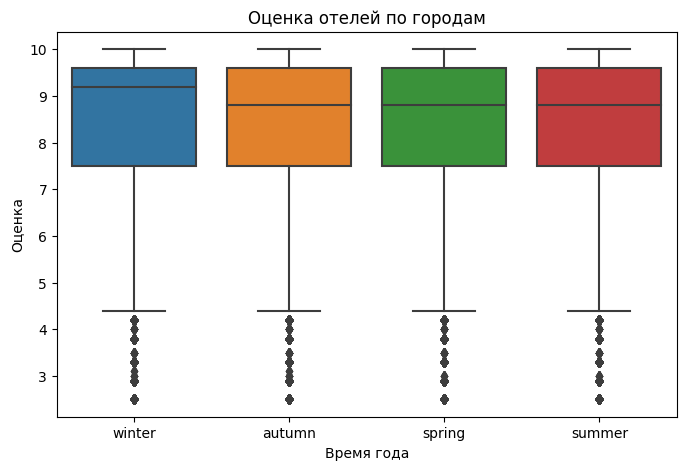

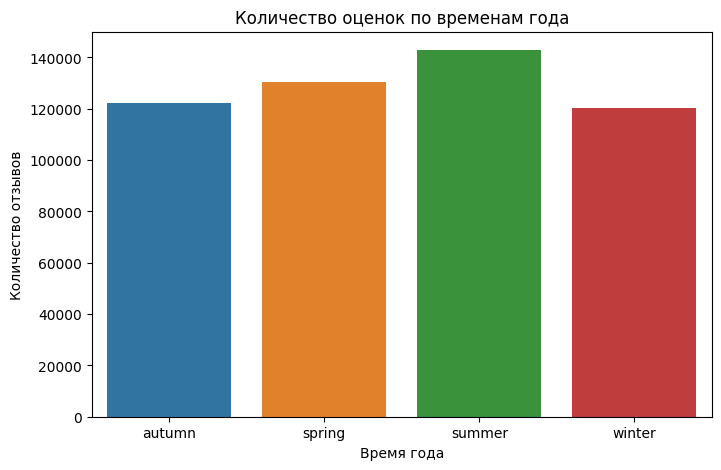

In [50]:
# Построим график изменения оценок по временам года
# build_graph('px', 'box', df_bking[df_bking['sample'] == 1], 'review_season', 'reviewer_score', 8, 5, 'Оценка отелей по городам', 'Время года', 'Оценка', color='review_season')
build_graph('plt', 'box', df_bking[df_bking['sample'] == 1], 'review_season', 'reviewer_score', 8, 5, 'Оценка отелей по городам', 'Время года', 'Оценка')

# Проверим, в какой сезон больше оценок
season_count = df_bking.groupby('review_season')['reviewer_score'].count().reset_index()
# build_graph('px', 'bar', df_bking[df_bking['sample'] == 1], 'review_season', 'reviewer_score', 8, 5, 'Оценка отелей по городам', 'Время года', 'Количество отзывов', color='review_season')
build_graph('plt', 'bar', season_count, 'review_season', 'reviewer_score', 8, 5, 'Количество оценок по временам года', 'Время года', 'Количество отзывов')

Визуализация показывает, что в зимнее время года, оценки выше в среднем, чем в иные времена года. Показатель имеет место быть, при построение модели, т.к. по временам года можно определить, где же будет меньше или больше оценка за посещение отеля.
Так же мы видим, что топ по количеству путеществий(*это я предположил исходя из количество отзывов*) приходятся на летний период. Да и отпуска люди берут чаще летом, поэтому это в какой-то степени логично.

И на последок рассмотрим, как же изменяется показатели оценок более точечно, а именно по месяцам:

In [51]:
# Перед построением графика, приведем месяца из чисел в привычный нам вид,
# для лучшего восприятия и читаемости

month_names = {
    1: 'January',
    2: 'February',
    3: 'March',
    4: 'April',
    5: 'May',
    6: 'June',
    7: 'July',
    8: 'August',
    9: 'September',
    10: 'October',
    11: 'November',
    12: 'December'
}

# Создадим копию датасета, чтобы после не преобразовывать или не плодить
# колоноки. Данный датасет, нам нужен будет исключительно для графика.
df_data = df_bking.copy()
# Заменяем названия
df_data['review_month'] = df_data['review_month'].replace(month_names)
# Изменяем формат
df_data['review_year'] = df_data['review_year'].astype(str)

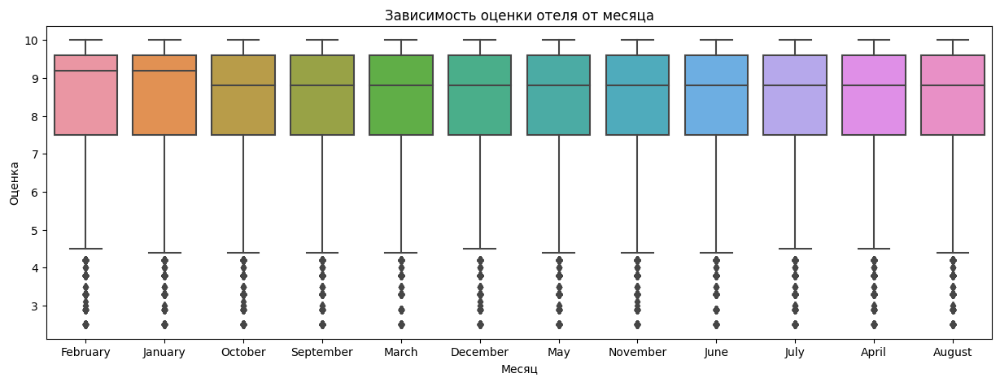

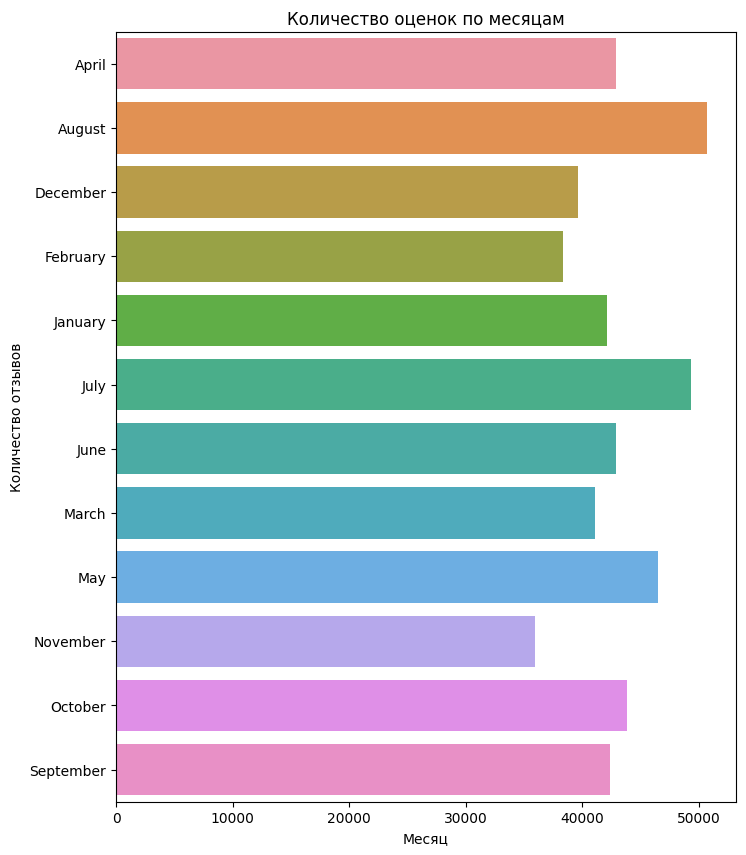

In [52]:
# График с средними ценками
# build_graph('px', 'box', df_data[df_bking['sample'] == 1], 'review_month', 'reviewer_score', 8, 5, 'Зависимость оценки отеля от месяца', 'Месяц', 'Оценка', color='review_month')
build_graph('plt', 'box', df_data[df_bking['sample'] == 1], 'review_month', 'reviewer_score', 15, 5, 'Зависимость оценки отеля от месяца', 'Месяц', 'Оценка')

# Сгруппируем месяца и количество оценок, для построения графика
month_df_count = df_data.groupby('review_month')['reviewer_score'].count().reset_index()

# build_graph('px', 'bar', df_bking[df_bking['sample'] == 1], 'review_month', 'reviewer_score', 8, 5, 'Количество оценок по месяцам', 'Время года', 'Количество отзывов', color='review_month')
build_graph('plt', 'bar', month_df_count, 'reviewer_score', 'review_month', 8, 10, 'Количество оценок по месяцам', 'Месяц', 'Количество отзывов')


Точечные графики подтверждают сезонность, в январе и феврале, люди каким-то непонятным образом тают от отелей, и ставят оценку на порядок выше, чем в остальные месяцы. Больше всего поездки совершают в июле и в авгусе, так что если вы хотите не попасть в этот пик народа то, стоит выбирать февраль и ноябрь для путешествий. Возможно и ваши оценки по отелям вырастут в эти месяца 

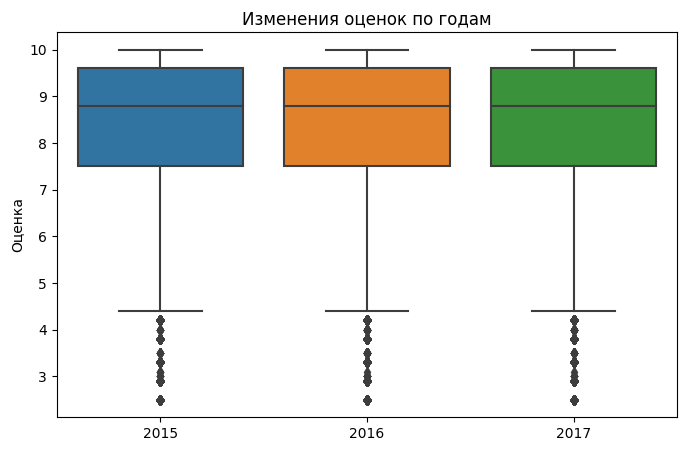

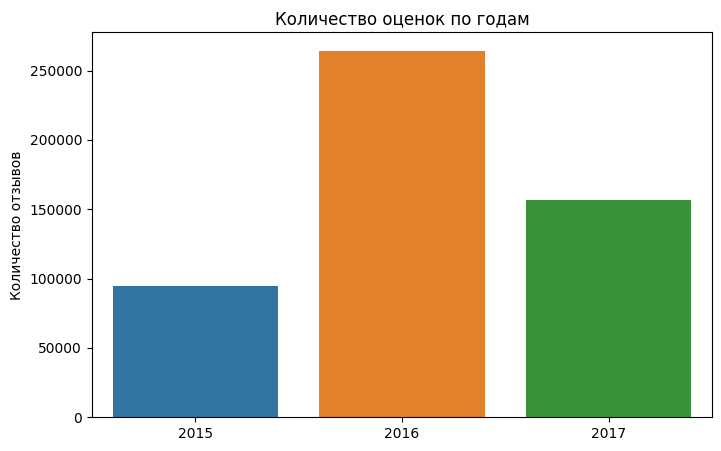

In [53]:
# График с оценками по годам
# build_graph('px', 'box', df_bking[df_bking['sample'] == 1], 'review_year', 'reviewer_score', 8, 5, 'Изменения оценок по годам', '', 'Оценка', color='review_year')
build_graph('plt', 'box', df_bking[df_bking['sample'] == 1], 'review_year', 'reviewer_score', 8, 5, 'Изменения оценок по годам', '', 'Оценка')

# Сгруппируем года и количество оценок, для построения графика
season_count = df_data.groupby('review_year')['reviewer_score'].count().reset_index()

# build_graph('px', 'bar', season_count, 'review_year', 'reviewer_score', 8, 5, 'Количество оценок по годам', '', 'Количество отзывов', color='review_year')
build_graph('plt', 'bar', season_count, 'review_year', 'reviewer_score', 8, 5, 'Количество оценок по годам', '', 'Количество отзывов')

Год посещения отеля сильно не влияет на изменения оценки, думаю, что данный признак не особо будет полезен. Да, количество оценок из года в год изменяется, но на показатель оценки это никак не влияет. Может быть, если бы был год открытия отеля, можно было бы поиграть с этим признаком, но в данной работе, считаю не стоит углубляться в поиски, парсинги информации по отелям и т.д.
Также, на мой взгляд сезон и месяц отеля, в какой-то степени дублируют друг друга, но пока оставим этот показатель, ближе к модели посмотрим, как они зависят друг от друга, а пока избавимся от переработанных и проанализируемых признаков, которые не будет использовать в дальнейшем.

In [54]:
# Закодируем сезоны:
df_bking = onehot_column(df_bking, 'review_season')

In [55]:
# Добавим признаки для удаления:
drop_list.extend(['review_date', 'review_year'])

<p style = "background-color : #ad2dfc; border-radius: 5px 5px; padding : 10px"><strong>

<a id='5'></a>
<p style = "background-color : #fc2d84; border-radius: 5px 5px; padding : 10px"><strong>

# 5. Анализ национальностей (reviewer_nationality)

<p style = "background-color : #fc2d84; border-radius: 5px 5px; padding : 10px"><strong>

А теперь рассмотрим национальности, выделим самых популярных посетителей отелей

In [56]:
# Выделим топ 10 чаще встречаемых национальностей
national_top10 = df_bking['reviewer_nationality'].value_counts(normalize=True).nlargest(10)*100
# И общее количество
national_count = df_bking['reviewer_nationality'].value_counts().shape[0]
print(colored(f'Количество строк:\n{national_top10}','magenta'))
print(colored(f'\nУникальные национальности: {national_count}','magenta'))

Количество строк:
 United Kingdom               47.552439
 United States of America      6.871124
 Australia                     4.204848
 Ireland                       2.874909
 United Arab Emirates          1.984535
 Saudi Arabia                  1.735571
 Netherlands                   1.700864
 Switzerland                   1.682637
 Germany                       1.539735
 Canada                        1.530622
Name: reviewer_nationality, dtype: float64

Уникальные национальности: 227


Довольно большое количество уникальных значений национальностей, которые оставляли оценки, при этом половина оценок из United Kingdom. Создадим колонку, для определения высталял эту оценку земляк или приезжий. Возможно, те кто местный ставил оценку более лояльно отелю.

Но для начала проверим нет ли в колонке пустых записей: 

In [57]:
# Проверка на пустые записи
cnt_no_nationality = df_bking[df_bking.reviewer_nationality.str.strip() == ''].shape[0]
print(colored(f'Количество записей без указанной национальности: {cnt_no_nationality}','magenta'))


Количество записей без указанной национальности: 523


Всё же есть, но их не так много. Обработаем пропущенные значения в наборе данных. Вариантов несколько:
1. Можем оставить пропуски как есть заменив их к примеру на строку 'unknown';
1. Заполнить на основе наиболее часто встречащихся значений национальностей:
1. Заполнить случайными значениями из имеющихся в столбце национальностей.

Количество мизерное в сравнение с общим объемом, и в данном случае, я думаю нет какого-то наилучшего варианта среди перечисленных, но предлагается, чтобы не пустовали у нас ячейки заполнить их по 3-му варианту случайными значениями, пусть это сделает за нас бог рандома :D


In [58]:
# Сгенерируем случайные значения из имеющихся в столбце 'reviewer_nationality'
random_values = np.random.choice(df_bking['reviewer_nationality'].dropna(), size=cnt_no_nationality)

# Заполним пустые записи в столбце 'reviewer_nationality' сгенерированными случайными значениями
df_bking.loc[df_bking.reviewer_nationality.str.strip() == '', 'reviewer_nationality'] = random_values

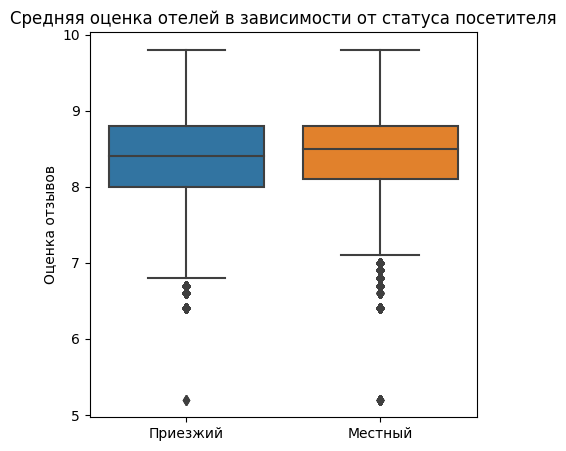

Количество посетителей:
Местный     337218
Приезжий    178520
Name: local_or_visiting, dtype: int64


In [59]:
# Избавимся от пробелов
df_bking['reviewer_nationality'] = df_bking['reviewer_nationality'].str.strip()
# Cоздадим новую колонку для сравнения
df_bking['local_or_visiting'] = df_bking.apply(lambda row: 'Приезжий' if row['hotel_country'] == \
                                                 row['reviewer_nationality'] else 'Местный', axis=1)

# График с оценками по годам
# build_graph('px', 'box', df_bking, 'local_or_visiting', 'average_score', 5, 5, 'Средняя оценка отелей в зависимости от статуса посетителя', '', 'Оценка отзывов', color='local_or_visiting')
build_graph('plt', 'box', df_bking, 'local_or_visiting', 'average_score', 5, 5, 'Средняя оценка отелей в зависимости от статуса посетителя', '', 'Оценка отзывов')

# Посмотрим, сколько у нас местных, а сколько приезжих
total_number = df_bking['local_or_visiting'].value_counts()
print(colored(f'Количество посетителей:\n{total_number}', 'magenta'))

Да, по количеству давших оценку отелю местных посетителей больше, практически в два раза! В целом, на разницу оценки отеля это сильного влияния, но тем неменее на 0.1 балл, средний показатель оценки выше, чем у приезжих. Возможно туристы ожидают чуточку больше от сервиса.
Пока не принято решению по необходимости данного признака, взглянем чуть позже, стоит ли его удалять.

А пока, рассмотрим, влияет ли показатель национальности на оценку отеля, и кто выше всех оценивает отель. 

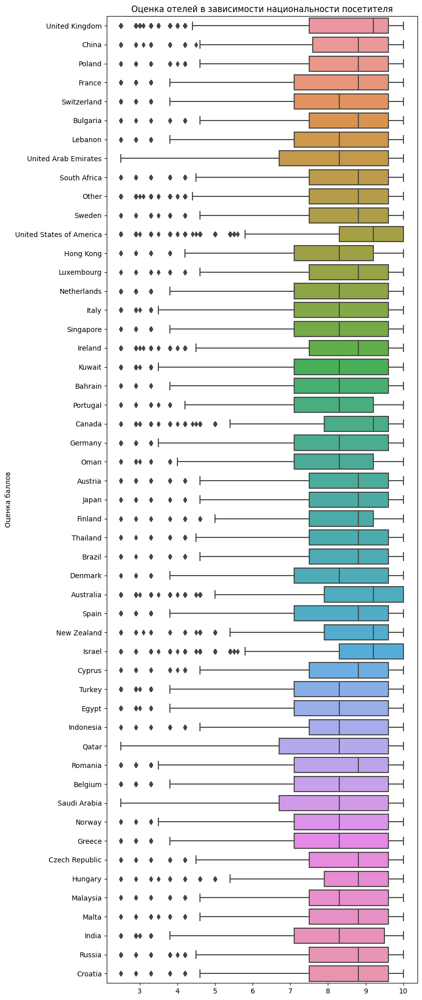

In [60]:
# Создаем список из 25 наиболее часто встречающихся отзывиков по национальности
nation_list = list(df_bking['reviewer_nationality'].value_counts().nlargest(50).index)

# Преобразовываем список
df_bking['reviewer_nationality'] = df_bking['reviewer_nationality'].apply(lambda x: 'Other' if x not in nation_list else x)

# build_graph('px', 'box', df_bking[df_bking['sample']==1], 'reviewer_nationality', 'reviewer_score', 8, 12, 'Оценка отелей в зависимости национальности посетителя', '', 'Оценка баллов', color='reviewer_nationality')
build_graph('plt', 'box', df_bking[df_bking['sample']==1], 'reviewer_score', 'reviewer_nationality', 8, 25, 'Оценка отелей в зависимости национальности посетителя', '', 'Оценка баллов')


Однозначно оставляем этот показатель, различия и влияние национальности присутствует. Поэтому закодируем полученные признаки. Так как у нас 51 уникальное значение выходит в колонке принято решение использовать двоичное кодирование, чтобы не размножать колонки в датасете, не усложнять и не нагружать вычисления. 

In [61]:
# Закодируем топ национальностей
df_bking = binary_column(df_bking, 'reviewer_nationality')
# Закодируем местных и приезжих
df_bking = onehot_column(df_bking, 'local_or_visiting')

<p style = "background-color : #fc2d84; border-radius: 5px 5px; padding : 10px"><strong>

<a id='6'></a>
<p style = "background-color : #2927a3; border-radius: 5px 5px; padding : 10px"><strong>

# 6. Анализ тегов [tags]

<p style = "background-color : #2927a3; border-radius: 5px 5px; padding : 10px"><strong>

Выведим 20 первых тегов, и рассмотрим, из чего состоит признак:

In [62]:
see_row('tags')

[' Leisure trip ', ' Couple ', ' Studio Suite ', ' Stayed 2 nights ', ' Submitted from a mobile device ']
[' Business trip ', ' Couple ', ' Standard Double Room ', ' Stayed 1 night ']
[' Leisure trip ', ' Solo traveler ', ' Modern Double Room Echo ', ' Stayed 3 nights ', ' Submitted from a mobile device ']
[' Leisure trip ', ' Solo traveler ', ' Standard Room with 1 Double Bed ', ' Stayed 1 night ']
[' Business trip ', ' Couple ', ' Standard Double or Twin Room ', ' Stayed 6 nights ']
[' Business trip ', ' Solo traveler ', ' Superior Twin Room ', ' Stayed 1 night ', ' Submitted from a mobile device ']
[' Leisure trip ', ' Couple ', ' Double Room Non Smoking ', ' Stayed 1 night ', ' Submitted from a mobile device ']
[' Leisure trip ', ' Couple ', ' Superior Double Room ', ' Stayed 4 nights ']
[' Leisure trip ', ' Couple ', ' Double Room ', ' Stayed 1 night ']
[' Leisure trip ', ' Couple ', ' Twin Hilton Guest Room ', ' Stayed 1 night ', ' Submitted from a mobile device ']
[' Business tr

Итак, есть парочка моментов:
1. Количество тегов ненормированно;
1. Есть пустые места в тегах и лишниие символы;
1. Необходимо привести в структурированный вид строки данного признака

In [63]:
# Для проработки признака выведем в отдельный лист теги,
# и подрасчешим признаки:
tags = set()
tags_list = list()
for index, value in df_bking['tags'].items():
        tags_count = value
        tags_count = tags_count.replace('[', '').replace(']', '')
        tags_count = tags_count.replace("'", '')
        tags_count = tags_count.split(",")
        for i in tags_count:
            tags.add(i.strip())
            tags_list.append(i.strip())

# Посчитаем общее количество уникальных тегов
print(colored(f'Общее количество уникальных тегов:\n{len(tags)} штук', 'blue'))

Общее количество уникальных тегов:
2428 штук


In [64]:
# Посмотрим на самые популярные теги
tags_series = pd.Series(
    data = tags_list,
    index = tags_list,
    name = 'tags_series'
)

# Сколько раз появляется каждый тег
counts_tags = tags_series.value_counts()
# добавим процентное содержание к тегам, в зависимоти от общего количества
percentages_tags = counts_tags.div(counts_tags.sum()) * 100
# метод div() для деления каждого значения на общее количество тегов


# Добавим колонку с процентным содержанием
result = pd.concat([counts_tags, round(percentages_tags,2)], axis=1)
result.columns = ['Количество тегов', 'Процент']

# Выделим 20 популярных тегов
top_tags = result[:20]
# Посмотрим сколько эти теги занимают от общего числа тегов в процентах
sum_of_percentages = top_tags['Процент'].sum()

print(colored(f'Топ 20 тегов:\n{top_tags}','blue'))
# Посмотрим сколько процентов занимают топ 20 тегов
print(colored(f'\nПроцент от общего количества тегов: {round(sum_of_percentages,2)}%','blue'))

Топ 20 тегов:
                                Количество тегов  Процент
Leisure trip                              417778    17.73
Submitted from a mobile device            307640    13.05
Couple                                    252294    10.71
Stayed 1 night                            193645     8.22
Stayed 2 nights                           133937     5.68
Solo traveler                             108545     4.61
Stayed 3 nights                            95821     4.07
Business trip                              82939     3.52
Group                                      65392     2.77
Family with young children                 61015     2.59
Stayed 4 nights                            47817     2.03
Double Room                                35207     1.49
Standard Double Room                       32248     1.37
Superior Double Room                       31393     1.33
Family with older children                 26349     1.12
Deluxe Double Room                         24823     1.05


**Что мы можем почерпнуть из тегов:**
1. В топ 20 тегов входит практически 85% всех тегов в датасете, что скорее всего не плохо;

1. Из тегов мы можем выяснить:
- тип поездки (туристическая, командировка);
- способ отправки отзыва;
- количество ночей (1, 2, 3, 4, 5);
- тип номера (двухместный, стандартный, улучшенный, и т.д.);
- Количество людей (пара, группа, один, семья);

В целом зависимости от информации по популярным тегам можно создать множество из них. **Предположим, что чаще всего на отзывы по отелю влияет типы номеров.**
Посмотрим как часто встречаются теги описывающие типы номеров. В целом, можно увидить, какие номера чаще приобретают, в зависимоти от номера какой отзыв оставляется и, наверное, у большинства отелей разное отношение идет к клиентам в зависимости от того, сколько они потратят финансов на отель.  

In [65]:
# Предполагается, что при описании типа комнаты 
# чаще употребляется два слова в тегах "Room" "room".
# Выполним выбор признаков по этим словам 
filtered_tags = tags_series.loc[tags_series.str.contains('Room', case=False)]
# Параметр case=False - используется для игнорирования регистра.


# Вывод отфильтрованных признаков
counts_room = filtered_tags.value_counts()

# добавим процентное содержание к тегам, в зависимоти от общего количества
percentages_room = counts_room.div(counts_room.sum()) * 100
# метод div() для деления каждого значения на общее количество тегов


# Добавим колонку с процентным содержанием
result = pd.concat([counts_room, round(percentages_room, 2)], axis=1)
result.columns = ['Количество тегов', 'Процент']

print(colored(f'Топ 20 тегов:\n{result[:20]}','blue'))

sum_of_percentages = result['Процент'][:20].sum()
print(colored(f'\nПроцент от общего количества тегов: {round(sum_of_percentages,2)}%','blue'))



Топ 20 тегов:
                              Количество тегов  Процент
Double Room                              35207     7.25
Standard Double Room                     32248     6.64
Superior Double Room                     31393     6.46
Deluxe Double Room                       24823     5.11
Double or Twin Room                      22393     4.61
Standard Double or Twin Room             17483     3.60
Classic Double Room                      16989     3.50
Superior Double or Twin Room             13570     2.79
2 rooms                                  12393     2.55
Standard Twin Room                        9745     2.01
Single Room                               9670     1.99
Twin Room                                 8321     1.71
Executive Double Room                     6425     1.32
Classic Double or Twin Room               6107     1.26
Superior Twin Room                        6064     1.25
Deluxe Double or Twin Room                5998     1.23
Club Double Room                  

20 самых популярных тегов с типом комнаты занимают чуть меньше 60% всех тегов, большое количество инфомации не указано по комнатам. Наверное, можно было бы потратить больше времени на разбор и рассмотрение всех тегов, возможно по типам комнат есть ещё масса ключевых слов, которые можно было бы добавить в фильтр, а ещё было бы здорово если бы в соревновании была табилца с прейскурантом на отели по типам комнат, можно б было оценить и проанализировать гораздо больше информации и получить что-то более вкусное на выходе.
Но на данном этапе обучения, в первом соревновании, не вижу особой надобности углубляться в этот процесс, поэтому выберим, что-нибудь плюс минус интересное с точки зрения влияния оценки на отзыв и добавим в свою модел обучения. 

Как правило категория номера определяется площадью, количеством комнат и спальных мест, набором услуг, входящих в цену номера, количеством и периодичностью проведения уборочных работ, оснащением мебелью, оборудованием, ассортиментом канцелярских, туалетных и других принадлежностей индивидуального пользования, набором рекламно-информационных материалов, типом кровати, видом из окна, наличием балкона, лоджии или террасы и другими факторами.
Поисковые результаты показали, что в настоящее время не существует единой международной градации номерного фонда в гостиницах, на которую можно было ориентироваться, поэтому предлагается выделить самостоятельно несколько категории номеров. Это будет **Высшая категория**, **Средняя категория**  и **Стандартная категория**.


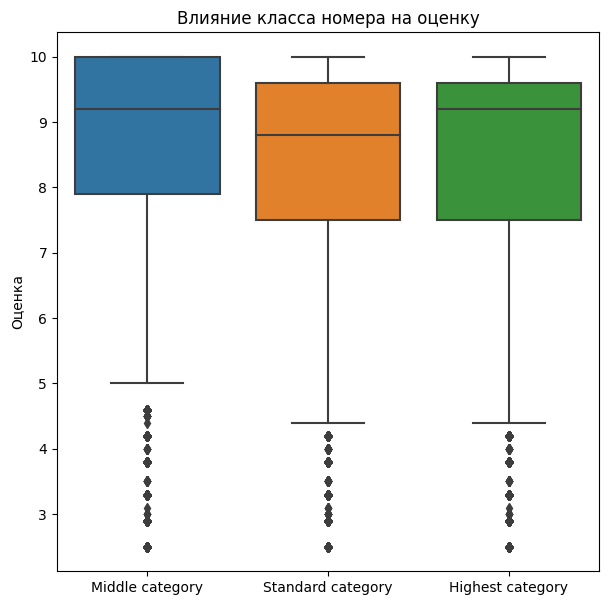

Количество оценок в каждой категории:
Standard category    298644
Highest category     117211
Middle category       99883
Name: room_class, dtype: int64%


In [66]:
# Напишем функцию, которая по ключевым словам в тэгах будет определять класс номера. Если не указан класс жилья в тэгах, 
# то будем считать что это номер класса стандарт. Отмечу, что важно начинать именно с люкс категории, потому что если в 
# тэге присутствует 2 слова из разных категорий, например Suite и Luxury, то этот тэг нужно отнести именно к категории люкс.  
def get_class_room(arg):
    if 'Executive' in arg or 'Deluxe' in arg or 'Luxury' in arg or 'Royal' in arg or 'Queen' in arg:
        return 'Highest category'
    elif 'Comfort' in arg or 'Superior' in arg or 'Suite' in arg:
       return 'Middle category'
    return 'Standard category'
            
df_bking['room_class'] = df_bking['tags'].apply(get_class_room) # применим функцию
rooms_category = df_bking['room_class'].value_counts() 

# Визуализируем
# build_graph('px', 'box', df_bking[df_bking['sample']==1], 'room_class', 'reviewer_score', 7, 7, 'Влияние класса номера на оценку', '', 'Оценка', color='room_class')
build_graph('plt', 'box', df_bking[df_bking['sample']==1], 'room_class', 'reviewer_score', 7, 7, 'Влияние класса номера на оценку', '', 'Оценка')

print(colored(f'Количество оценок в каждой категории:\n{rooms_category}%','blue')) # посмотрим на распределение


- Отлично, мы видим, что тип номера влияет на его оценку, значит это показатель будет пригоден для модели, закодируем его в конце пункта.

Теперь рассмотрим цель посещения отеля, те, кто по работе и те кто едут на отдых.
Мнение таково: люди посещают отель с точки зрения отдыха, скорее всего выдадут больше отзывов, чем тип людей, которые находятся в по работе.
Давайте изучим, какое количество людей с какой целью посещали отель, мы видили **'Business trip', 'Leisure trip'**, но может быть найдем чего ещё интересного.
Для этого в тегах присутвует такой тезис, как `trip`, взглянем на объем, который охватывают теги с данным тезисом:

In [67]:
trip_list = set()

for elem in tags_list:
    if 'trip' in elem:
        trip_list.add(elem)

trip_list

{'Business trip', 'Leisure trip'}

Отлично, среди тегов, где присутвует тезис trip есть две вариации, по работе - **Business trip** и отдых/туризм - **Leisure trip**. Посчитаем сколько у нас каких рецензентов, и определим количество которое не указало данный тезиc:

In [68]:
def get_trip(arg):
    """Функция выделения из тегов тезисов по типу поездки

    Args:
        arg: строка с тегами

    Returns:
        Вариации поездки
    """    
    if 'Business trip' in arg:
        return 'Business'
    if 'Leisure trip' in arg:
        return 'Leisure'
    else:
        return 'No thesis'

# Создаем новую колонку
df_bking['trips'] = df_bking['tags'].apply(get_trip)

# Выведим информацию по количеству преобразованных тегов:
tags_c = df_bking['trips'].value_counts()

print(colored(f'Цель посещения отеля:\n{tags_c}%','blue'))

Цель посещения отеля:
Leisure      417778
Business      82939
No thesis     15021
Name: trips, dtype: int64%


Преобладающее число тегов относится к путешественникам, также у нас есть места, где отсутствует один из возможных тегов, обратимся к богу рандома и пусть он сам раздаст каждому такой тег, который считает нужным:

In [69]:
# Замена значения 'No thesis' случайным образом на 'Travel' или 'Work'
replacement_values = np.random.choice(['Leisure', 'Business'], size=len(df_bking))
df_bking['trips'] = np.where(df_bking['trips'] == 'No thesis', replacement_values, df_bking['trips'])

# что у нас выйдет в результате
tags_c_edit = df_bking['trips'].value_counts()
print(colored(f'Цель посещения отеля:\n{tags_c_edit}%','blue'))


Цель посещения отеля:
Leisure     425120
Business     90618
Name: trips, dtype: int64%


Теги созданы, теперь взглянем как же изменяются отценки посетителей отелей в зависимости от этих двух тезисов:

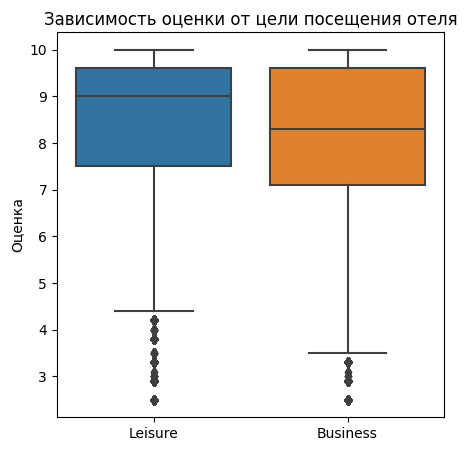

In [70]:
# build_graph('px', 'box', df_bking[df_bking['sample']==1], 'trips', 'reviewer_score', 5, 5, 'Зависимость оценки от цели посещения отеля', '', 'Оценка', color='trips')
build_graph('plt', 'box', df_bking[df_bking['sample']==1], 'trips', 'reviewer_score', 5, 5, 'Зависимость оценки от цели посещения отеля', '', 'Оценка')

Визуализация показала, что в тип поездки влияет на оценку. Те, кто просто путешествуют выставляют оценку гораздо выше, чем рецензеты которые по работе приехали в отель.
Исходя из того, что преобладающее количество людей оставило отзывы в путешествии, они же и чаще посещают отели, и количество рецензентов больше, можно сказать, что стоит больше прислушиваться к оценкам `Travel` рецензентам. А по работе, скорее всего большая часть людей часто в разъездах, больше видели отелей, больше требований к отелям выставляют, поэтому могут быть оценки ниже. На самом деле очень много вариантов и причин по выставлению оценки отелям для разных типов поездок. Оставим этот признак для модели и, пожалуй, сразу создадим бинарные признаки:

In [71]:
# Кодируем новые признаки
df_bking = onehot_column(df_bking, 'trips')

Второй по количеству тегов идет `Submitted from a mobile device` посмотрим, как данный показатель влияет на оценку. Кто более же пишеьт лучше отзывы

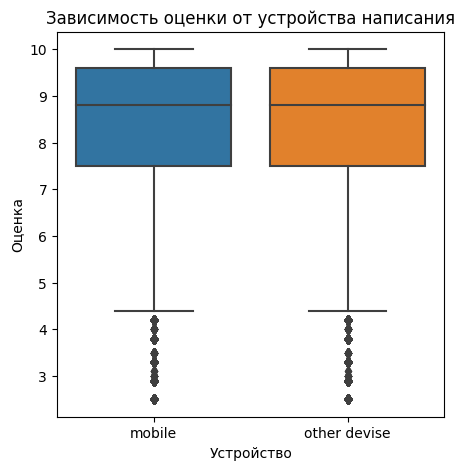

In [72]:
# Создаем новую колонку с девайсами:
df_bking['device_tags'] =df_bking['tags'].apply(lambda x: 'mobile' if 'Submitted from a mobile device' in x else 'other devise')


# build_graph('px', 'box', df_bking[df_bking['sample']==1], 'device_tags', 'reviewer_score', 5, 5, 'Зависимость оценки от устройства написания', 'Устройство', 'Оценка', color='device_tags')
build_graph('plt', 'box', df_bking[df_bking['sample']==1], 'device_tags', 'reviewer_score', 5, 5, 'Зависимость оценки от устройства написания', 'Устройство', 'Оценка')

Визуализация показала, что на размер оценки устройство на котором был написан отзыв не особо и влияет. Возможно на сайте при сбора тегов, либо автоматически определяется девайс и тег выставляется, либо есть автоматическая подборка тегов, приложение определяет девайс и предалагает, а пользователь видит тег с галочой и они нажимают на неё. Я думаю, что мало кто будет запариваться и при написании отзыва на отель будет говорить с какого он устройства пишет. Нам не нужен данный признак в модели, уберём его сразу.

In [73]:
drop_list.extend(['device_tags'])

Ну и на последок по тегам рассмотрим ещё один часто встречающий тег, а точнее набор тегов который показывает состав посетителей отелей: `Solo travel`, `Couple`, `Group`, `Family with older children`, `Family with yound children`.

In [74]:
def get_travelers(arg):
    """Функция по преобразованию тегов состава посетителей

    Args:
        arg: Строка с тегами

    Returns:
            Отформатированные и унифицированные теги состава посетителей
    """    
    if 'Solo traveler' in arg:
        return 'Solo travele'
    elif 'Couple' in arg:
        return 'Couple'
    elif 'Group' in arg:
        return 'Group'
    elif 'Family with older children' in arg or 'Family with young children' in arg:
        return 'Family'
    else:
        return 'Unknown'

df_bking['travelers'] = df_bking['tags'].apply(get_travelers)
travelers = df_bking['travelers'].value_counts()

print(colored(f'Количество тегов в зависимости от группы посетителей:\n{travelers}%','blue'))

Количество тегов в зависимости от группы посетителей:
Couple          252294
Solo travele    108545
Family           87364
Group            65392
Unknown           2143
Name: travelers, dtype: int64%


Ага, значит есть у нас строки, где люди поленились заполнить в каком составе они ездили, но мы не ленивые, попросим компьютер заполнить за них случайными показателями, так будет честнее:

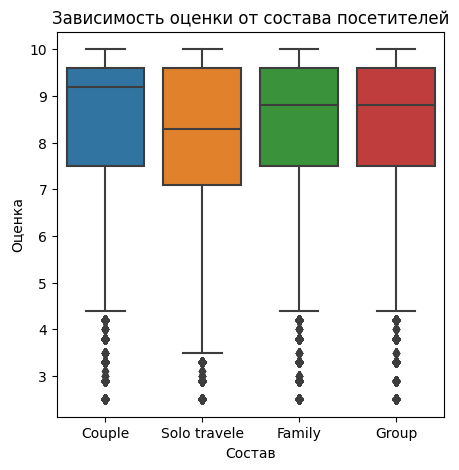

Количество тегов в зависимости от группы посетителей:
Couple          252838
Solo travele    109100
Family           87878
Group            65922
Name: travelers, dtype: int64%


In [75]:
# Замена значения 'No thesis' случайным образом на 'Travel' или 'Work'
replacement_values = np.random.choice(['Solo travele', 'Couple', 'Group', 'Family'], size=len(df_bking))
df_bking['travelers'] = np.where(df_bking['travelers'] == 'Unknown', replacement_values, df_bking['travelers'])

# что у нас выйдет в результате

# build_graph('px', 'box', df_bking[df_bking['sample']==1], 'travelers', 'reviewer_score', 5, 5, 'Зависимость оценки от состава посетителей', 'Состав', 'Оценка', color='travelers')
build_graph('plt', 'box', df_bking[df_bking['sample']==1], 'travelers', 'reviewer_score', 5, 5, 'Зависимость оценки от состава посетителей', 'Состав', 'Оценка')

travelers_edit = df_bking['travelers'].value_counts()

print(colored(f'Количество тегов в зависимости от группы посетителей:\n{travelers_edit}%','blue'))

Итак, парочки `Couple` ставят медианную оценку гораздо выше чем остальные, а тем, кому видимо нехватало окситоцина `Solo travele` снижали рейтинг отеля, ну и слишком большое количество людей в поездках `Family`, `Group` не увеличат оценку отеля, а дадут что-то среднее.
Показатель влияет на оценку - однозначно. Оставляем. Кодируем.  

- кодирования признака типа путешествия **Business**, **Leisure**
- кодирование признака состава группу путешественников

In [76]:
# Класс комнаты
df_bking = onehot_column(df_bking, 'room_class')

# Группа путешественников
df_bking = onehot_column(df_bking, 'travelers')

In [77]:
# Добавляем в копилочку
drop_list.extend(['tags'])

По тегам закончили. Двигаемся дальше

<p style = "background-color : #2927a3; border-radius: 5px 5px; padding : 10px"><strong>

<a id='7'></a>
<p style = "background-color : #e1f505; border-radius: 5px 5px; padding : 10px"><strong>

# 7. Негативные и позитивные отзывы [negative_review, positive_review]

<p style = "background-color : #e1f505; border-radius: 5px 5px; padding : 10px"><strong>

Взглянем, что же пишут люди по отзывам в отели. Начнем с негативных

In [78]:
see_row('negative_review')

 Leaving 
 poor breakfast
 No kettle in room 
No Negative
 Torn sheets 
 Nothing
 Nothing it was lovely 
 The communal areas are a bit soul less and the breakfast whilst very good is expensive But you can always use the cafe at the tram stop Elise I think for breakfast and late night drinks We did 
 undergoing refurbishment no tea coffer in room room very small no ramp at entrance for wheeled suitcases no coffee available in lounge next morning early checkout at 11 00am
 I advised it was for my husbands birthday and reception gave us a twin room when i booked a double I asked for little extras to be put in the room for his birthday and it was given too late and didnt make it special 
 They have lost their license and cannot sell alcohol or change your currency 
 feel there isnt much to be improved upon with this hotel excellent all round
No Negative
 N A
No Negative
No Negative
 Nothing hotel refurb great
 Nothing 
 I got a room in Basment 1 room 09 in same time next room 10 has some m

Исходя из выше представленного, можно предположить, что отзыв содержащий большой количество слов действительно раскрывает отзыв как и негативный, но есть и те, которые не относятся к ним, и они как правило, сокращены в пару слов, не более 3 - 5 слов. Как пример **Nothing,  Nothing it was lovely ? N A, No Negative** и было бы не плохо их трансформировать и убрать как негатив. Рассмотрим короткие негативные отзывы:

In [79]:
# Используем функцию подсчета частоты встречаемости элементов
# Берем колонку с количеством отзывов и устанавливаем условие не более 5 слов на негативный отзыв
negative_words = df_bking[df_bking['review_total_negative_word_counts'] <= 5]['negative_review']

# Используйте Counter для подсчета частоты встречаемости элементов
counter_words_negative = Counter(negative_words)

# Получаем наиболее часто встречаемые слова
most_common_negative = counter_words_negative.most_common(25)

# Для просмотра точечно популярность
# most_common = counter_words_negative.most_common(100)[75:100]

# Выводим c условием repr - для отображения пробелов и других символов, если они присутствуют
for element, count in most_common_negative:
    print(repr(element), count)

'No Negative' 127890
' Nothing' 14295
' Nothing ' 4236
' nothing' 2225
' N A' 1037
' None' 984
' ' 849
' N a' 509
' Breakfast' 407
' Small room' 373
' Location' 368
' Everything' 326
' All good' 318
' Nothing really' 316
' none' 302
' nothing ' 283
' No complaints' 274
' Price' 260
' Nothing really ' 254
' Nil' 247
' n a' 227
' Nothing at all' 221
' Nothing to dislike' 209
' Nothing at all ' 194
' Small rooms' 188


Теперь вы видим топ слов, которые не относятся к отрицательным отзывам, даже выведеных 25 первых популярных отзывов достаточно, чтобы определить что необходимо заменять..но я почему-то, решил не много по копаться и проработать 100 первых встречаемых по частоте таких слов.
В целом, остальные же, которые с частотой повторения менее 100 думаю можно и не учитывать, сильной роли они не сыграют и имею слишком малый процент для нашей будущей модели, а время затрачивать на данную обратку не вижу особого смысла. Временные трудозатраты на вычесывания каждой песчинки не сопоставимы с условием на сколько улучшиться модель в данном случае.

In [80]:
# Создадим список слов, которые не являются отрицательными:
# (В список добавленые ещё слова, которые состоят более чем из 5 слов
# при дальнейшем разборе нашел ещё парочку часто встречаемыъ отзывов,
# котороые не являются негативными, решил подкорректировать)
not_negative_list = ['No Negative', ' Nothing', ' Nothing ', ' nothing' ' N A', ' None', ' ', ' N a', ' All good',
                ' none', ' nothing ', ' No complaints', ' Nil',' Nothing really ', ' n a', ' Nothing to dislike',
                ' Nothing at all', ' Nothing at all ',' No complaints ', ' All good ', ' NA', ' Na',
                ' Liked everything', ' Not much', ' Non', ' Having to leave ', ' All was good', ' Absolutely nothing', 
                ' Everything was great ', ' Everything was perfect', ' NOTHING', ' I liked everything',' Not applicable',
                 ' Nothing to complain about', ' Nothing all good', ' No thing', ' I liked everything ', ' Everything was fine',
                  ' Having to leave', ' Nothing all good ', ' Nothing to dislike', ' Nothing to dislike ', 'Excellent hotel', 
                ' Nothing comes to mind ', ' There was nothing we didn t like ', ' Nothing I can think of ', ' Nothing I didn t like',
                ' There was nothing to dislike ', ' There was nothing I didn t like']

# Список слов негатива по расположению:
location_negative_list = [' Location', ' location', ' Location']


# Список слов негатива по еде:
eat_negative_list = [' Breakfast too expensive', ' The breakfast', ' Breakfast not included', ' Poor breakfast', ' Breakfast could be better',
                     ' Price of breakfast', ' Expensive breakfast', ' breakfast', ' Breakfast' ]            

# Список слов негатива по комнатам и прочее:
room_negative_list = [' Room', ' Noise', ' Small bathroom', ' Small bathroom', ' Bed', ' No gym', ' Nothing in particular', ' Small rooms ',
                        ' Room was small', ' small rooms', ' nothing really', ' Room a bit small', ' Parking', ' Pillows', ' The price', 
                        ' Small room ', ' No parking', ' Size of room', ' As above', ' Room too small', ' Bathroom', ' Wifi', 
                        ' Room was very small', ' Room very small', ' Very small rooms', ' Size of the room', ' Expensive', ' Room size',
                        ' Very small room', ' Staff', ' See above', ' small room', ' Not much', ' Small room', ' Nothing really',
                        ' Price', ' Small rooms', ' Facilities', 'Noise, Bad and small room, expensive price']


# И список, которые являются слишком негативными:
very_negative_list  = [' Everything', ' Nothing not to like', ' All', ' Leaving ', ' Leaving', ' everything', ' Every thing', ' Everything else',
                       ' leaving', 'Did not like it much', 'Everything is terrible' ]


# Преобразуем получившиеся списки
def make_negative_reviews(words):
    """Преобразовываем списки по отзывам

    Args:
        words: Списки слов в отзывах

    Returns: Унифицированные отзывы
    """
    if words in not_negative_list:
        return 'Excellent hotel'
    elif words in location_negative_list:
        return 'Bad location'
    elif words in eat_negative_list:
        return 'Bad and expensive breakfast'
    elif words in room_negative_list:
        return 'Noise, bad and small room, expensive price'        
    elif words in very_negative_list:
        return 'Everything is terrible'
    return 'Did not like it much'



# Применим функцию
unification_negative = df_bking['review_total_negative_word_counts'] <= 5
df_bking.loc[unification_negative, ['negative_review']] = df_bking['negative_review'].apply(make_negative_reviews)
    
# Взглянем на распределение
df_bking[df_bking['review_total_negative_word_counts'] <= 5]['negative_review'].value_counts()


Excellent hotel                               153467
Did not like it much                           43307
Noise, bad and small room, expensive price      3581
Bad and expensive breakfast                      937
Everything is terrible                           816
Bad location                                     445
Name: negative_review, dtype: int64

In [81]:
see_row('positive_review')

 Staff were amazing
 location
No Positive
 Friendly staff quiet comfortable room spotlessly clean excellent location 
 The staff was very friendly and helpful Breakfasts were just extraordinary Room was clean quiet and very spacious 
 Very nice hotel Price is excellent when compared to quality Very quiet Good food 
 Very central location 2 minutes walk from Gloucester Rd tube station and 10 15 minutes walk from the museums Lots of restaurants and bars on the doorstep 
 The location is good for transport links especially if you are a tram lover the number 2 stops two minutes away easy walk to the centre past the rathaus and as a bonus there is an excellent non smoking cafe opposite the tram stop We had a superior privilege room which was a strange shape with sloping roof even though we weren t on the top floor very bling gold decor I liked the Klimpt bathroom door but comfortable clean and with a good walk in shower The street above the hotel has a supermarket some nice niche shops and 

В целом картина такая же у негативных, рассмотрим более детально:

In [82]:
# Берем колонку с количеством отзывов и устанавливаем условие не более 5 слов на негативный отзыв
positive_words = df_bking[df_bking['review_total_positive_word_counts'] <= 5]['positive_review']

# Используйте Counter для подсчета частоты встречаемости элементов
counter_words_positive = Counter(positive_words)

# Получаем наиболее часто встречаемые слова
most_common_positive = counter_words_positive.most_common(25)

# Для просмотра точечно популярность
# most_common_positive = counter_words_positive.most_common(100)[75:100]

# Выводим c условием repr - для отображения пробелов и других символов, если они присутствуют
for element, count in most_common_positive:
    print(repr(element), count)

'No Positive' 35946
' Location' 9222
' Everything' 2284
' location' 1677
' Nothing' 1243
' The location' 1126
' Great location' 1047
' Good location' 927
' Location ' 915
' Everything ' 613
' Breakfast' 608
' Friendly staff' 515
' Staff' 453
' Excellent location' 392
' Great location ' 372
' Location and staff' 333
' everything' 319
' Good location ' 276
' Nothing ' 225
' Comfy bed' 222
' nothing' 217
' The location ' 215
' good location' 206
' The staff' 197
' Good breakfast' 189


In [83]:
# Создадим список слов, которые не являются позитивными:
not_positive_list = ['No Positive', ' Nothing',' Nothing ',' nothing', ' ',' Not much', ' Location only',  ]

# Список слов, которые относятся к хорошей части позитива, это связано с комнатой, локациями и ценами
location_positive_list = [' Location',' location', ' The location', ' Great location', ' Good location', ' Location ',
                        ' Excellent location', ' Great location ', ' Location and staff', ' Good location ',  ' The location ',
                        ' good location', ' the location', ' Location was good', ' Location was great',' Location staff',
                        ' Perfect location', ' Excellent location ', ' Location is great', ' great location',  ' Location is good', 
                        ' Location location location',  ' Central location', ' Location was excellent', ' Position',  ' Staff and location',
                        ' Excellent breakfast', ' Very good location', ' Location and breakfast', ' Location was great ',
                        ' Location Staff',' Location was good ',  ' Location is excellent', ' Location is perfect',  
                        ' Location and friendly staff', ' Convenient location', ' Location and cleanliness', ' Location location location ',
                        ' Location is great ',  ' Fantastic location', ' Nice location', ' The view', ' Great location friendly staff',
                        ' Location was perfect', ' Great Location', ' Location breakfast',]

# еДА
eat_positive_list = [' Breakfast',' Good breakfast',' Breakfast was good', ' Great breakfast', ' breakfast',' The breakfast',
                    ' Breakfast was good ']

# Комнаты
room_positive_list = [ ' Comfy bed', ' Clean',  ' The bed', ' The room', ' All good',' Room', ' Very comfortable bed',
                    ' The bed was comfy', ' Very clean',' Bed', ' Bed was comfy',]

# Персонал:
staff_positive_list = [' Friendly staff', ' Staff', ' The staff', ' Very friendly staff', ' Helpful staff', ' Staff were excellent',
                    ' Great staff', ' Friendly helpful staff', ' Very helpful staff',' Friendly staff ',' Excellent staff',
                    ' Service',' Staff very friendly', ' friendly staff',' Friendly and helpful staff',]
                        

# И список, где прям всё понравилось:
very_positive_list  = [' Everything', ' Everything ', ' everything', ' All', ' Every thing',' Everything was perfect',
                        ' Everything was perfect ', ' Excellent', ' Everything was excellent', ' Everything was great',
                        ' All of it' ,' Comfortable bed', ' Cleanliness', ]


# Преобразуем получившиеся списки
def make_positive_reviews(words):
    """Преобразовываем списки по отзывам

    Args:
        words: Списки слов в отзывах

    Returns: Унифицированные отзывы
    """
    if words in not_positive_list:
        return 'did not like anything'
    elif words in eat_positive_list:
        return 'Great breakfast'
    elif words in room_positive_list:
        return 'Clear and comfortable room'
    elif words in location_positive_list:
        return 'Great and convenient location'
    elif words in staff_positive_list:
        return 'Great and friendly staff'                
    return 'Not a bad hotel'


# # Применим функцию
unification_positive = df_bking['review_total_positive_word_counts'] <= 5
df_bking.loc[unification_positive, ['positive_review']] = df_bking['positive_review'].apply(make_positive_reviews)
    
# Взглянем на распределение
df_bking[df_bking['review_total_positive_word_counts'] <= 5]['positive_review'].value_counts()


Not a bad hotel                  67490
did not like anything            38020
Great and convenient location    20607
Great and friendly staff          2320
Great breakfast                   1325
Clear and comfortable room        1151
Name: positive_review, dtype: int64

Отлично, позитивные и негативные короткие отзывы рассмотрели, теперь взглянем на более длинные отзывы, там где более 5 слов:

In [84]:
# Берем колонку с количеством отзывов и устанавливаем условие не более 5 слов на негативный отзыв
negative_words_total = df_bking[df_bking['review_total_negative_word_counts'] >= 12]['negative_review']

# Используйте Counter для подсчета частоты встречаемости элементов
counter_words_total_negative = Counter(negative_words_total)

# Получаем наиболее часто встречаемые слова
most_common_total_negative = counter_words_total_negative.most_common(25)

# Для просмотра точечно популярность
# most_common_total_negative = counter_words_total_negative.most_common(100)[75:100]

# Выводим c условием repr - для отображения пробелов и других символов, если они присутствуют
for element, count in most_common_total_negative:
    print(repr(element), count)

' I can t think of anything I didn t like ' 10
' Would have liked tea coffee making facilities in the room ' 5
' Water overflow from bathroom while taking bath Interconnect disconnects again and again Need to go through a procedure to connect it again Nuisance Very small rooms No covered wardrobes for cloth You have to hang it in open air Housekeeping sometimes forgot to put tissues in the bathroom sometimes forget to put soap sometimes drinking water No restaurant in the hotel Have to arrange food from outside restaurant with hotel s help Had to pay Euro 50 for late checkout' 4
' I can t think of anything we didn t like ' 3
' There was nothing I didn t like about this hotel ' 3
' There were no tea coffee making facilities in the room ' 3
' Although I have rated the hotel well for the questions asked I will not be staying at the hotel again A group of 6 of us went 2 in King Suites the other four were meant to be in twins When we got there the hotel informed us all they had were doubles

In [85]:
# Берем колонку с количеством отзывов и устанавливаем условие не более 5 слов на негативный отзыв
positive_words_total = df_bking[df_bking['review_total_positive_word_counts'] >= 12]['positive_review']

# Используйте Counter для подсчета частоты встречаемости элементов
counter_words_total_positive = Counter(positive_words_total)

# Получаем наиболее часто встречаемые слова
most_common_total_positive = counter_words_total_positive.most_common(25)

# Для просмотра точечно популярность
# most_common_total_positive = counter_words_total_positive.most_common(100)[75:100]

# Выводим c условием repr - для отображения пробелов и других символов, если они присутствуют
for element, count in most_common_total_positive:
    print(repr(element), count)

' The room was very spacious and nicely arranged to separate business and leisure Friendly personnel extra nice The whole service The personnel was perfect and the room very comfortable ' 8
' The hotel the staff and location are fantastic Quiet gracious room I felt very safe at this hotel I am glad that I spent my holiday here ' 6
' Friendly and supportive staff New construction clean rooms Heated bathrooms No noise 3 lifts Location near to metro station and the destination where I wanted to visit everyday Good seating capacity for the restaurant during breakfast Good variety in the breakfast Ability to order halal food through the hotel staff' 3
' The location is great and the staff are very helpful ' 3
' To be honest everything warm hospitality and the service was amazimg very helpful staff definitely i will be back again ' 3
' The only good thing about this hotel is the location ' 3
' The location was excellent and the staff were very friendly and helpful ' 3
' The bed was very comf

Исходя из вышепредставленных отзывов, видно, что не распознается некоторые символы, и было бы не плохо их не много подкорректировать, для корректной работы программы:

In [86]:
# Создадим список неправильно записанных сокращений
correct_list = ["don t", "Don t", "didn t", "Didn t", "wouldn t","Wouldn t", "couldn t", "Couldn t", 
                   "wasn t", "Wasn t", "aren t", "isn t", "Isn t", "doesn t", "Doesn t", "weren t", 
                   "Weren t", "hasn t", "haven t", "Haven t", "won t", "Won t", "shouldn t", "Shouldn t"]

# Напишем корректирующую функцию
def correct_func(words):
    """Функция корректировки слов

    Args:
        words: принимаем проблемные слова

    Returns: задаем правильный вид
    """    ''''''
    for word in correct_list:
        if word in words:
            return words.replace(word, word.replace(" ", "'"))
    return words

# Применим ее
df_bking['negative_review'] = df_bking['negative_review'].apply(correct_func)
df_bking['positive_review'] = df_bking['positive_review'].apply(correct_func)

Отзывы подрасчесали, теперь при помощи инструмента анализа тональности текста, определим эмоциональную окраску текстового содержания отзывов. Даннный инструмент позволит оценить текст на положительность, отрицательность и нейтральность, путем присваевания числового значения(показатель тональности).

In [87]:
# Создаем объекты SentimentIntensityAnalyzer:
sia_neg = SentimentIntensityAnalyzer()
sia_pos = SentimentIntensityAnalyzer()

# Выполняем анализ тональности отзывов:
df_bking['n_analyzer'] = df_bking['negative_review'].apply(lambda x: sia_neg.polarity_scores(x))
df_bking['p_analyzer'] = df_bking['positive_review'].apply(lambda x: sia_pos.polarity_scores(x))

# Признаки тональности негативных отзывов:
df_bking['n_neg'] = df_bking['n_analyzer'].apply(lambda x: x['neg'])
df_bking['n_neu'] = df_bking['n_analyzer'].apply(lambda x: x['neu'])
df_bking['n_pos'] = df_bking['n_analyzer'].apply(lambda x: x['pos'])
df_bking['n_compound'] = df_bking['n_analyzer'].apply(lambda x: x['compound'])

# Признаки тональности позитивных отзывов
df_bking['p_neg'] = df_bking['p_analyzer'].apply(lambda x: x['neg'])
df_bking['p_neu'] = df_bking['p_analyzer'].apply(lambda x: x['neu'])
df_bking['p_pos'] = df_bking['p_analyzer'].apply(lambda x: x['pos'])
df_bking['p_compound'] = df_bking['p_analyzer'].apply(lambda x: x['compound'])

In [88]:
df_bking[['n_neg', 'n_neu', 'n_pos', 'n_compound', 'p_neg', 'p_neu', 'p_pos', 'p_compound']].head(5)

,n_neg,n_neu,n_pos,n_compound,p_neg,p_neu,p_pos,p_compound
0,0.608,0.392,0.000,-0.4767,0.000,0.412,0.588,0.4310
1,0.345,0.655,0.000,-0.2755,0.000,0.423,0.577,0.6249
2,0.423,0.577,0.000,-0.2960,0.413,0.587,0.000,-0.2755
3,0.000,0.213,0.787,0.5719,0.000,0.279,0.721,0.9169
4,0.345,0.655,0.000,-0.2755,0.000,0.618,0.382,0.8503


В целом, отзывы выглядят не плохо, и оценки тоже ничего, можно даже не много их улучшить путём редакции и более детального анализа отзывов, но пожалуй, оставим пока всё как есть

In [89]:
drop_list.extend(['negative_review', 'positive_review', 'p_analyzer', 'n_analyzer'])

<p style = "background-color : #e1f505; border-radius: 5px 5px; padding : 10px"><strong>

<a id='8'></a>
<p style = "background-color : #ff003b; border-radius: 5px 5px; padding : 10px"><strong>

# 8. Количество слов в отзывах [review_total_negative_word_counts, review_total_positive_word_counts]

<p style = "background-color : #ff003b; border-radius: 5px 5px; padding : 10px"><strong>

Рассмотрим, как влияет количество слов в отзыве на оценку отеля. Для начала взглянем, сколько слов чаще всего пишут в отзывах

In [90]:
neg_count = df_bking['review_total_negative_word_counts'].value_counts().head(12)
pos_count = df_bking['review_total_positive_word_counts'].value_counts().head(12)

print(colored(f'Топ 10 по количеству слов в негативных отзывах:\n{neg_count}%','red'))
print(colored(f'\nТоп 10 по количеству слов в позитивных отзывах:\n{pos_count}%','red'))

Топ 10 по количеству слов в негативных отзывах:
0     127890
2      24647
3      18144
6      17749
5      16809
7      16140
4      15063
8      14716
9      13641
10     12422
11     11526
12     10936
Name: review_total_negative_word_counts, dtype: int64%

Топ 10 по количеству слов в позитивных отзывах:
0     35946
6     26921
5     26844
4     24656
7     24538
8     23238
3     22533
9     21208
2     20934
10    19611
11    18015
12    16365
Name: review_total_positive_word_counts, dtype: int64%


Отлично, мы видим, что есть ещё и пустые колонки, так и заполненные.
Чаще всего в негативных отзывах количество слов варьируется от 2 до 12 слов, и больше, чаще по 2 слова. В позитивных, более раскрыты, чаще всего можно увидеть отзывы, где 6 слов.
Взглянем на распределение отзывов по количеству:

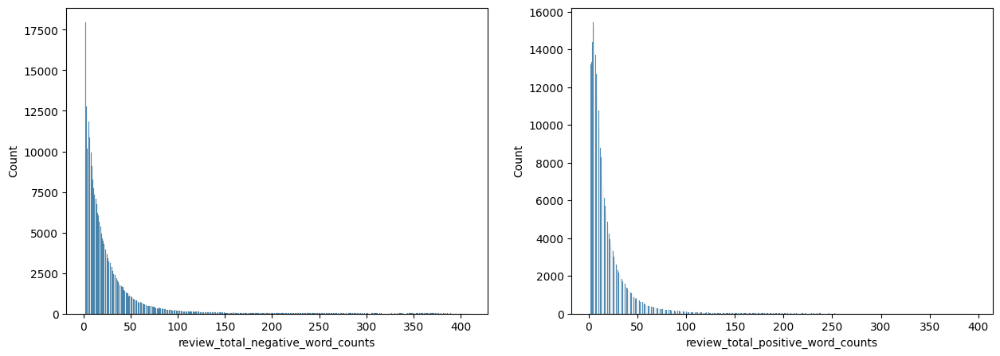

In [91]:
# Убираем 0 значения
filtered_df = df_bking[(df_bking['sample'] == 1) & (df_bking['review_total_negative_word_counts'] != 0) & (df_bking['review_total_positive_word_counts'] != 0)]

# Визуализируем наши распределения:
fig, axes = plt.subplots(1, 2, figsize=(15, 5))
histplot1 = sns.histplot(data=filtered_df, x='review_total_negative_word_counts', ax=axes[0])
histplot2 = sns.histplot(data=filtered_df, x='review_total_positive_word_counts', ax=axes[1])

plt.show()


Разброс очень большой и значений много..попробуем разбить их на части:

In [92]:
def get_count_word(words):
    if words == 0:
        return 'Without a review' # Без реценззи
    elif words <= 6: # Взял 6, т.к. в позитивных чаще всего 6 слов пишут
        return 'Short review 1' # Короткий 1 уровня
    elif 6 < words <= 10:
        return 'Short review 2' # Короткий 2 уровня
    elif 10 < words <= 20:
        return 'Average review 1' # Средний 1 уровня
    elif 20 < words <= 40:
        return 'Average review 2' # Средний 2 уровня
    elif 40 < words <= 60:
        return 'Long review 1' # Длиный 1 уровня
    elif 60 < words <= 80:
        return 'Long review 2' # Длиный 2 уровня
    elif 80 < words <= 100:
        return 'Essay 1' # Прям сочинение 1 уровня
    elif 100 < words <= 150:
        return 'Essay 2' # Прям сочинение 1 уровня     
    else:
        return 'Too much' # Слишком много
    
df_bking['negative_review_count_words'] = df_bking['review_total_negative_word_counts'].apply(get_count_word)
df_bking['positive_review_count_words'] = df_bking['review_total_positive_word_counts'].apply(get_count_word)

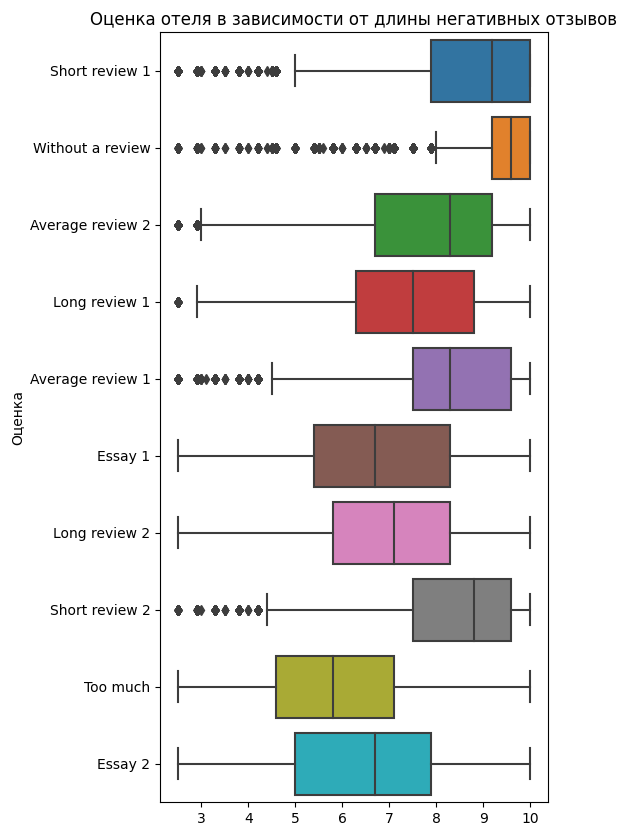

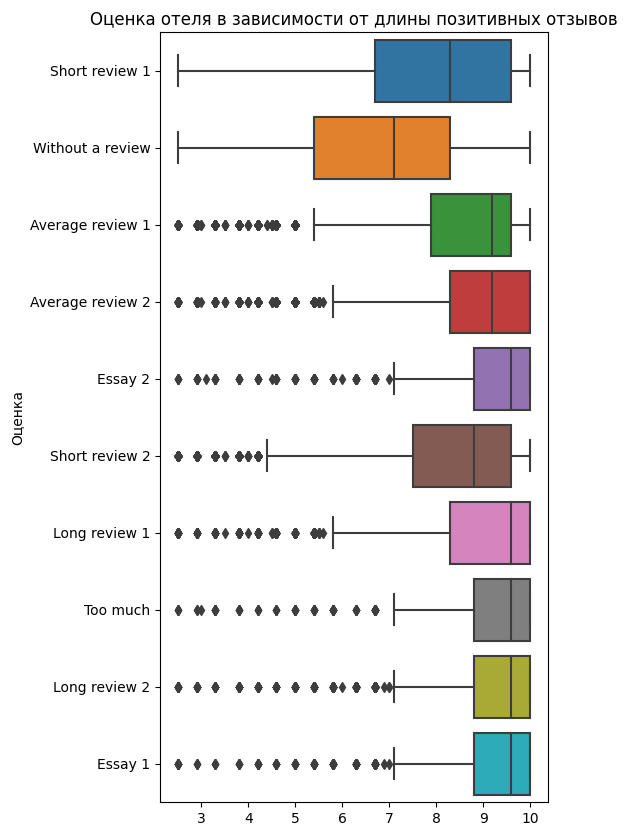

In [93]:
# build_graph('px', 'box', df_bking[df_bking['sample']==1], 'negative_review_count_words', 'reviewer_score', 5, 5, 'Оценка отеля в зависимости от длины негативных отзывов', '', 'Оценка', color='negative_review_count_words')
build_graph('plt', 'box', df_bking[df_bking['sample']==1], 'reviewer_score', 'negative_review_count_words', 5, 10, 'Оценка отеля в зависимости от длины негативных отзывов', '', 'Оценка')

# build_graph('px', 'box', df_bking[df_bking['sample']==1], 'positive_review_count_words', 'reviewer_score', 5, 5, 'Оценка отеля в зависимости от длины негативных отзывов', '', 'Оценка', color='negative_review_count_words')
build_graph('plt', 'box', df_bking[df_bking['sample']==1], 'reviewer_score', 'positive_review_count_words', 5, 10, 'Оценка отеля в зависимости от длины позитивных отзывов', '', 'Оценка')

Визуализация показала, что данные признаки важны и длина отзыва влияет на результат оценки отеля. 
Признаки длины отзывов отнесем к порядковому признаку, данное кодирование будет реализованно в классе OrdinalEncoder с методом fit_transform для установки соответствия с размерами.

In [94]:
# Создаем для словарь с описанием кодировки:
size_list = {'Without a review': 1,
             'Short review 1': 2, 'Short review 2': 3,
             'Average review 1': 4, 'Average review 2': 5,
             'Long review 1': 6, 'Long review 2': 7,
             'Essay 1': 8, 'Essay 2': 9,
             'Too much' : 10}

# Кодируем признаки:
ordinal_column(df_bking, 'positive_review_count_words', 'size_positive_words', size_list)
ordinal_column(df_bking, 'negative_review_count_words', 'size_negative_words', size_list)

In [95]:
drop_list.extend(['review_total_positive_word_counts', 'review_total_negative_word_counts'])

<p style = "background-color : #ff003b; border-radius: 5px 5px; padding : 10px"><strong>

<a id='9'></a>
<p style = "background-color : #89f760f2; border-radius: 5px 5px; padding : 10px"><strong>

# 9. Название отеля [hotel_name]

<p style = "background-color : #89f760f2; border-radius: 5px 5px; padding : 10px"><strong>

Есть предположение, что наименование отеля будет влиять на оценку. Название отеля, можно воспринять как своего рода бренд! 
Рассмотрим количество уникальных значений отелей

In [96]:
# определим количество уникальных отелей, и какое их количество:
df_bking['hotel_name'].value_counts()

Britannia International Hotel Canary Wharf           4789
Strand Palace Hotel                                  4256
Park Plaza Westminster Bridge London                 4169
Copthorne Tara Hotel London Kensington               3578
DoubleTree by Hilton Hotel London Tower of London    3212
                                                     ... 
Boundary Rooms Suites                                  12
Le Lavoisier                                           12
Hotel Wagner                                           10
Mercure Paris Porte d Orleans                          10
Hotel Gallitzinberg                                     8
Name: hotel_name, Length: 1492, dtype: int64

Значений очень много, аж 1492 штуки. Взглянем, как движется оценка отеля по названиям:

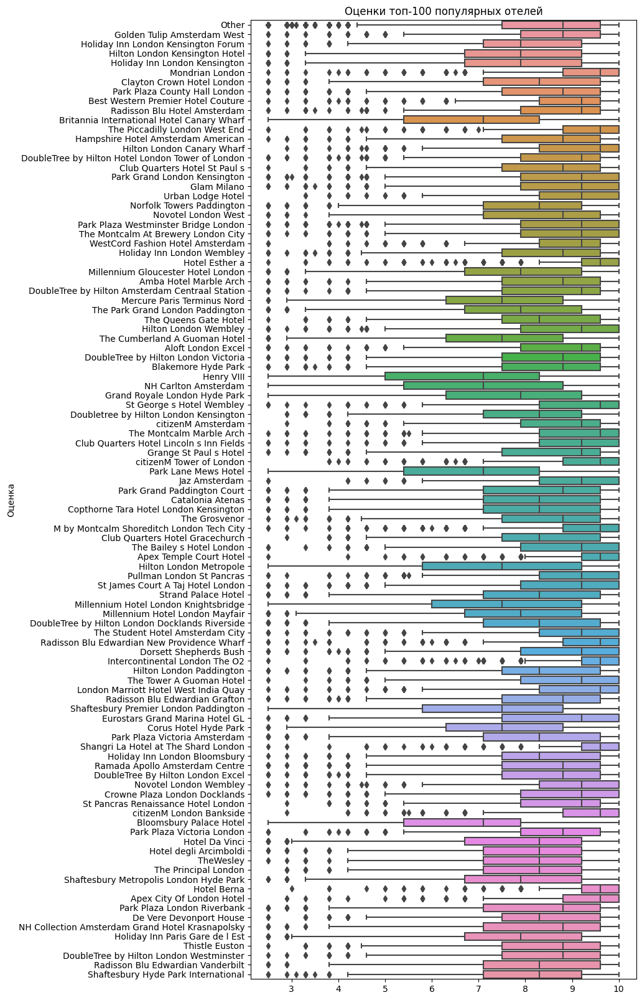

In [97]:
# Создаем список из 100 популярных отелей:
hotels_list = list(df_bking['hotel_name'].value_counts().nlargest(100).index)

# Преобразовываем список
df_bking['top_hotels'] = df_bking['hotel_name'].apply(lambda x: 'Other' if x not in hotels_list else x)

# build_graph('px', 'box', df_bking[df_bking['sample']==1], 'top_hotels', 'reviewer_score', 15, 8, 'Оценки топ-100 популярных отелей', '', 'Оценка', color='top_hotels')
build_graph('plt', 'box', df_bking[df_bking['sample']==1], 'reviewer_score', 'top_hotels', 8, 20, 'Оценки топ-100 популярных отелей', '', 'Оценка')

В какой-то степени работа над анализом данных является творческой, и мною было принято решение, провести небольшой анализ родителей представленных отелей, для того, чтобы сократить этот перечень и посмотреть, как движется оценка от одного гостиничного оператора к другому. По сути у каждого свои есть решения по сервису, по обслуживанию, по комплектации отелей и т.д. 
Безусловно, у каждого оператора, среди отелей которые есть в данных есть и подразделения на отели для каждого вида социума. Есть более бюджетные варианты отелей, есть средние, а есть премиум. Также, в зависимости от страны в которой находится отелей, оператор будет подбирать оптимальный ценновой диапазон, который захочет получать от потенциальных клиентов, и в зависимости от предполагаемой выручки, будет закупать и сервис и т.п. Я думаю, что логика рассуждения понятна. В данном проекте, не будет раздувать и увеличивать его объем, а просто обусловимся тем, что оценка отеля будет зависеть от оператора или же, для лучшего восприятия, назовем их центральными организациями групп отелей.


Поиск центральных организаций групп отелей проведен и извлечен из свободного доступа. 
Я выделил следующие организации:
1. [Holiday Inn](https://www.ihg.com/holidayinn/hotels/us/en/reservation);
1. [Hilton](https://www.hilton.ru/?ysclid=loh6pxs5up336564064);
1. [Radisson Hotels](https://www.radissonhotels.com/ru-ru/brand/radisson-blu?facilitatorId=RHGSEM&cid=a:ps+b:yan+c:emea+i:brand+e:rdb+r:tlb+f:ru-RU+g:cl+h:Multiple+v:cf&etext=&yclid=6489812621234870536);
1. [Dalata Hotel Group PLC](https://www.radissonhotels.com/ru-ru/brand/radisson-blu?facilitatorId=RHGSEM&cid=a:ps+b:yan+c:emea+i:brand+e:rdb+r:tlb+f:ru-RU+g:cl+h:Multiple+v:cf&etext=&yclid=6489812621234870536);
1. [WestCord Hotel](https://westcordhotels.com/);
1. [NH collection Hotel](https://www.nh-collection.com/en);
1. [Manchefert Group](https://www.machefert.com/);
1. [Accor](https://group.accor.com/)
1. [Marriot's Hotel](https://hoteltechreport.com/news/marriott-hotel-brands)
1. [City Development Limited](https://www.cdl.com.sg/)
1. [Clermont Hotel Group](https://www.clermonthotel.group)
1. [CitizenM](https://www.citizenm.com/hotels)
1. [Hrewards](https://hrewards.com/)
1. [Grange Hotels](https://www.grangehotels.com)

Те отели, которые не входят в данные организации будут под названием `Other Hotels`.

Для каждой центральной организации были выделенны ключевые слова по их дочерним отелям. Ниже представлены списки ключевых слов связок дочек с родитель организацией:

In [98]:
holiday_inn = ['Six', 'Senses', 'Regent', 'Intercontinental', 'Vignette', 'Kimpton', 'Indigo', 'Voco', 'Hualuxe', 'Crowne plaza', 'Iberostar', 'Even', 'Holiday', 'Garner', 'Avid', 'Atwell', 'Staybridge', 'Candlewood']
hilton = ['Waldorf', 'Astoria', 'LXR',  'Conrad', 'Canopy', 'Signia', 'Hilton', 'Curio', 'DoubleTree', 'Tapestry', 'Embassy', 'Tempo', 'Motto', 'Garden', 'Hampton', 'Tru', 'Spark', 'Homewood', 'Home2']
radisson_hotels = ['Radisson', 'Art otel', 'Park inn', 'Park Plaza', 'Rewards', 'Meeting']
dalata_hotel_group_plc = ['Dalata', 'PLC', 'Maldron', 'Clayton', 'Gibson', 'Samuel']
westCord_hotel = ['WestCord','Wadden', 'Seeduyn', 'Schylge', 'Boschrijck', 'Noordsee', 'WTC', 'Leeuwarden', 'Eindhoven', 'Veluwe', 'Art', 'City Centre', 'Delft', 'The Market', 'ss Rotterdam', 'Jacarta']
nh_collection_hotel = ['Minir', 'Anantara', 'Avani', 'Elewana', 'Oaks', 'NK', 'Nhow', 'Tivoli', 'NH']
manchefert_group = ['1L', 'Kube', 'Normandy', 'Chantier', 'Amazigh', 'Marrakech', 'Villa', 'Maison', 'Pavillon', 'Boulevards', 'Machefert']
accor = ['Accor', 'Adagio', 'Fairmont', 'Ibis', 'Mgallery', 'Mercure', 'Movenpick', 'Novotel', 'Pullman', 'SO', 'Swissotel', 'Rixos', 'Sofitel']
marriots_hotel = ['Marriott', 'JW', 'Ritz-Carlton', 'Regis', 'W', 'Delta', 'Sheraton', 'Renaissance', 'Protea', 'SpringHill', 'Aloft', 'TownePlace', 'Design Hotels', 'Autograph']
city_development_limited = ['Biltmore', 'Unique', 'Millennium', 'Msocial', 'Studio M', 'Copthorne', 'Kingsgate', 'Bailey', 'Chelsea Harbour', 'Grand Hotel Palace Rome']
clermont_hotel_group = ['Thistle', 'Marble', 'Piccadilly', 'Holborn', 'Bloomsbury', 'Clermont', 'Guoman', 'Thistleexpress', 'Tower', 'Horseguards', 'Cumberland', 'Charing', 'Victoria', 'Shoreditch']
citizenm = ['citizenM', 'Paris Opera', 'Champ', 'Gare', 'Lyon', 'Charles', 'Gaulle', 'Defense', 'Shoreditch', 'Bankside', 'Schiphol', 'Amstel', 'Amsterdam South']
hrewards = ['Steigenberger', 'Intercity', 'IntercityHotel', 'Maxx', 'Jaz']
grange_hotels = ['Grange', 'Beauchamp', 'Clearendon', 'Portland', 'Blooms']

Некоторые отели неполучилось распределить, большая часть из них идентифицировались как самостоятельные группы. Было принято решение оставить их как есть. Выделены топ-20 из предполагаемо входящих в `Other Group`

In [99]:
independent_hotels = ['Strand Palace Hotel',
                    'Grand Royale London Hyde Park',
                    'Park Grand Paddington Court',
                    'Blakemore Hyde Park',
                    'M by Montcalm Shoreditch London Tech City',
                    'St James Court A Taj Hotel London',
                    'Park Grand London Kensington',
                    'Hotel Da Vinci',
                    'Hotel Esther a',
                    'The Cumberland A Guoman Hotel',
                    'The Park Grand London Paddington',
                    'Ramada Apollo Amsterdam Centre',
                    'Mondrian London',
                    'The Student Hotel Amsterdam City',
                    'The Grosvenor',
                    'Shaftesbury Premier London Paddington',
                    'The Principal London',
                    'Glam Milano',
                    'Dorsett Shepherds Bush',
                    'Bloomsbury Palace Hotel']

А теперь создадим новую колонку на основе собранных списков

In [100]:
def get_new_hotel_name(hotel_name):
    if any(word.lower() in hotel_name.lower() for word in holiday_inn):
        return 'Holiday Inn'
    elif any(word.lower() in hotel_name.lower() for word in hilton):
        return 'Hilton'
    elif any(word.lower() in hotel_name.lower() for word in radisson_hotels):
        return 'Radisson Hotels'
    elif any(word.lower() in hotel_name.lower() for word in dalata_hotel_group_plc):
        return 'Dalata Hotel Group PCL'
    elif any(word.lower() in hotel_name.lower() for word in westCord_hotel):
        return 'WestCord Hotel'
    elif any(word.lower() in hotel_name.lower() for word in nh_collection_hotel):
        return 'NH Collection Hotel'
    elif any(word.lower() in hotel_name.lower() for word in manchefert_group):
        return 'Manchefert Group'
    elif any(word.lower() in hotel_name.lower() for word in accor):
        return 'Accor'
    elif any(word.lower() in hotel_name.lower() for word in marriots_hotel):
        return 'Marriots Hotel'
    elif any(word.lower() in hotel_name.lower() for word in city_development_limited):
        return 'City Development Limited'
    elif any(word.lower() in hotel_name.lower() for word in clermont_hotel_group):
        return 'clermont_hotel_group'
    elif any(word.lower() in hotel_name.lower() for word in grange_hotels):
        return 'grange_hotels'
    elif any(word.lower() in hotel_name.lower() for word in hrewards):
        return 'hrewards'
    elif any(word.lower() in hotel_name.lower() for word in citizenm):
        return 'citizenm'
    elif hotel_name in independent_hotels:
        return hotel_name
    else: 
        return 'Other Hotels'



df_bking['hotel_group'] = df_bking['hotel_name'].apply(get_new_hotel_name)


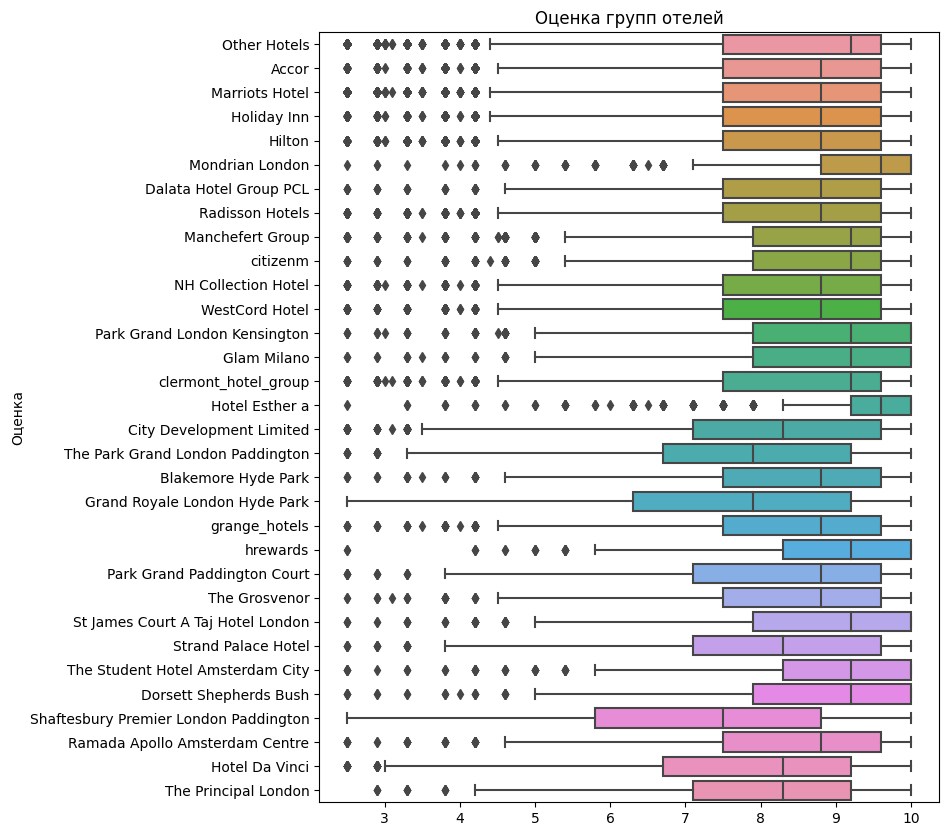

In [101]:
# build_graph('px', 'box', df_bking[df_bking['sample']==1], 'hotel_group', 'reviewer_score', 15, 8, 'Оценка групп отелей', '', 'Оценка', color='hotel_group')
build_graph('plt', 'box', df_bking[df_bking['sample']==1], 'reviewer_score', 'hotel_group', 8, 10, 'Оценка групп отелей', '', 'Оценка')



Картина вроде не плохая выходит, взглянем на количественную сторону по распеределению:

In [102]:
hotel_group = df_bking['hotel_group'].value_counts(normalize=True).nlargest(100)*100
hotel_group

Other Hotels                             40.153140
Marriots Hotel                           13.543505
Hilton                                    8.266019
Accor                                     5.803140
Holiday Inn                               5.558055
Radisson Hotels                           4.958138
clermont_hotel_group                      3.983030
WestCord Hotel                            3.314474
NH Collection Hotel                       2.675389
City Development Limited                  2.127631
Manchefert Group                          1.019316
grange_hotels                             0.838216
Strand Palace Hotel                       0.825225
citizenm                                  0.699580
Grand Royale London Hyde Park             0.573547
Park Grand Paddington Court               0.443636
Blakemore Hyde Park                       0.422307
St James Court A Taj Hotel London         0.401367
Park Grand London Kensington              0.399234
Dalata Hotel Group PCL         

Попытку и идею по распределению и улучшению изучения влияния оценки отеля на его названия оставлю. Но на мой взгляд, результат этого анализа вышел не таким, как ожидалось. У нас даже после проведения и распределения отелей по группам порядка 40% отелей не распределены, конечно, можно больше потратить времени и продолжить проработку данного признака, более точечно, но у нас нет этого времени, поэтому было принято решение не терять признак `hotel_name` и всё же закодировать его:

In [103]:
df_bking["hotel_name"] =df_bking["hotel_name"].astype('category')
df_bking["hotel_name"] = df_bking["hotel_name"].cat.codes

In [104]:
drop_list.extend(['hotel_group', 'top_hotels'])

<p style = "background-color : #89f760f2; border-radius: 5px 5px; padding : 10px"><strong>

<a id='10'></a>
<p style = "background-color : #325e22f2; border-radius: 5px 5px; padding : 10px"><strong>

# 10. Остаточные не закодированные признаки:

<p style = "background-color : #325e22f2; border-radius: 5px 5px; padding : 10px"><strong>

Взглянем на оставшиеся не обработанные колонки:

In [105]:
df_bking[['total_number_of_reviews','total_number_of_reviews_reviewer_has_given', 'days_since_review', 'additional_number_of_scoring']].info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 515738 entries, 0 to 515737
Data columns (total 4 columns):
 #   Column                                      Non-Null Count   Dtype 
---  ------                                      --------------   ----- 
 0   total_number_of_reviews                     515738 non-null  int64 
 1   total_number_of_reviews_reviewer_has_given  515738 non-null  int64 
 2   days_since_review                           515738 non-null  object
 3   additional_number_of_scoring                515738 non-null  int64 
dtypes: int64(3), object(1)
memory usage: 15.7+ MB


Практически все колонки имею числовой тип данных, за исключением **days_since_review**. Считаю, что на данном этапе и уже с выше проработанной информацией материалов для получения модели, с хорошими результатами будет достаточно. Углубляться и разбирать данные признаки с учетом первого подобного задания, пока не вижу надобности. В целом можно было бы поиграть и с данными и создать парочку новых признаков. Но пожалуй приведем все колонки к числову типу данных, и приступим к дальнейшему исследованию и построению модели.

In [106]:
# Приведем к числовому типу признак
df_bking['days_since_review'] = df_bking['days_since_review'].apply(lambda x: x.split()[0])
df_bking['days_since_review'] = df_bking['days_since_review'].astype('int')

In [107]:
# Рассмотрим описательную статистику:
round(df_bking[['total_number_of_reviews','total_number_of_reviews_reviewer_has_given', 'days_since_review', 'additional_number_of_scoring']].describe(),2)

,total_number_of_reviews,total_number_of_reviews_reviewer_has_given,days_since_review,additional_number_of_scoring
count,515738.00,515738.00,515738.00,515738.00
mean,2743.74,7.17,354.44,498.08
std,2317.46,11.04,208.93,500.54
min,43.00,1.00,0.00,1.00
25%,1161.00,1.00,175.00,169.00
50%,2134.00,3.00,353.00,341.00
75%,3613.00,8.00,527.00,660.00
max,16670.00,355.00,730.00,2682.00


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


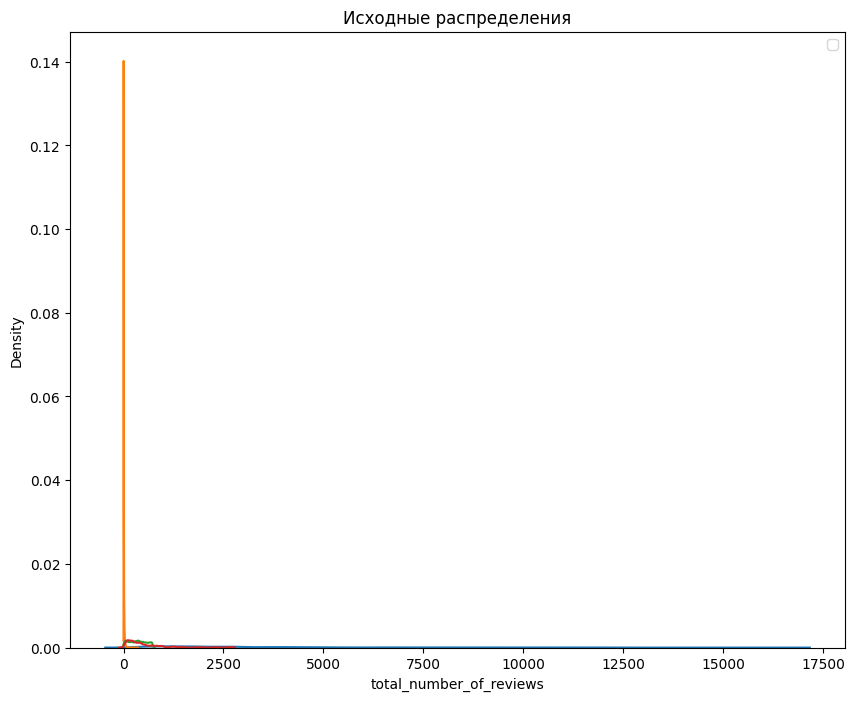

In [108]:
# зададим параметры холста, название и визуализируем кривые распределения:
fig, (ax1) = plt.subplots(ncols=1, figsize=(10, 8))
ax1.set_title('Исходные распределения')

# kdeplot() (KDE – оценка плотности ядра) – специальный метод для графиков распределений
sns.kdeplot(df_bking['total_number_of_reviews'], ax=ax1)
sns.kdeplot(df_bking['total_number_of_reviews_reviewer_has_given'], ax=ax1)
sns.kdeplot(df_bking['days_since_review'], ax=ax1)
sns.kdeplot(df_bking['additional_number_of_scoring'], ax=ax1)
plt.legend()

Признаки распределены не нормально и имеют выбросы. Так как признаки изначально не были очищены от выбросов то попробуем их преобразовать методом нормализации Robustscaler:

<Axes: title={'center': 'Распределения после RobustScaler'}, xlabel='total_number_of_reviews', ylabel='Density'>

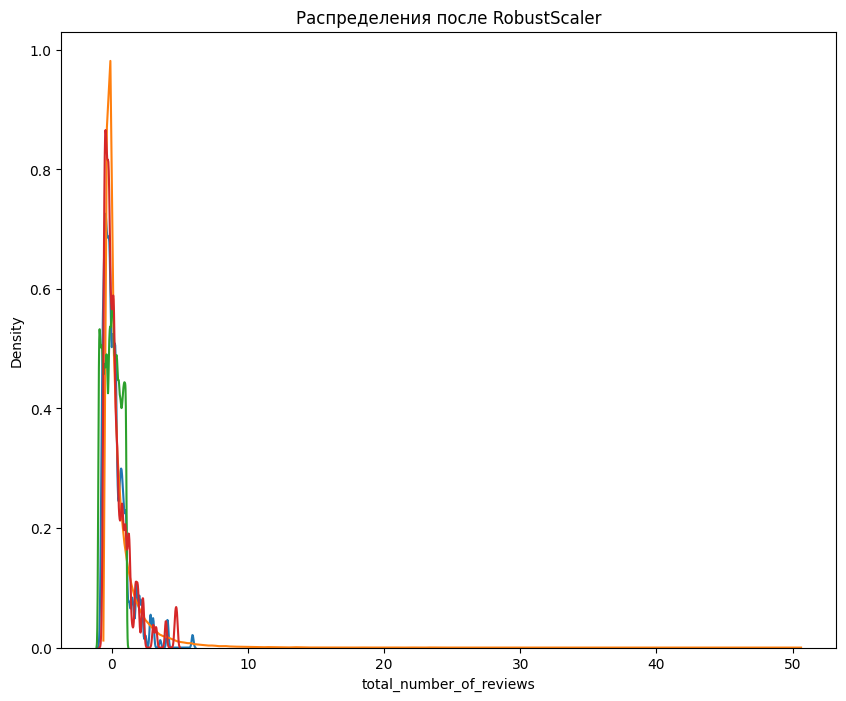

In [109]:
# Инициализируем нормализатор RobustScaler
r_scaler = preprocessing.RobustScaler()

# Признаки подлежащие нормализации
attribute_robust = ['total_number_of_reviews','total_number_of_reviews_reviewer_has_given', 'days_since_review', 'additional_number_of_scoring']

df_robust = r_scaler.fit_transform(df_bking[attribute_robust].values)

df_robust = pd.DataFrame(df_robust, columns=attribute_robust)

fig, (ax1) = plt.subplots(ncols=1, figsize=(10, 8))
ax1.set_title('Распределения после RobustScaler')

sns.kdeplot(df_robust['total_number_of_reviews'], ax=ax1)
sns.kdeplot(df_robust['total_number_of_reviews_reviewer_has_given'], ax=ax1)
sns.kdeplot(df_robust['days_since_review'], ax=ax1)
sns.kdeplot(df_robust['additional_number_of_scoring'], ax=ax1)

In [110]:
# Описательная статистика нормализации
round(df_robust[['total_number_of_reviews','total_number_of_reviews_reviewer_has_given', 'days_since_review', 'additional_number_of_scoring']].describe(),2)

,total_number_of_reviews,total_number_of_reviews_reviewer_has_given,days_since_review,additional_number_of_scoring
count,515738.00,515738.00,515738.00,515738.00
mean,0.25,0.60,0.00,0.32
std,0.95,1.58,0.59,1.02
min,-0.85,-0.29,-1.00,-0.69
25%,-0.40,-0.29,-0.51,-0.35
50%,0.00,0.00,0.00,0.00
75%,0.60,0.71,0.49,0.65
max,5.93,50.29,1.07,4.77


После преобразования картина признаков стала лучше выглядить, надеюсь это скажется на улучшении сходимости алгоритмов машинного обучения. Теперь, когда у нас несть нормализованные признаки заменим их в исходном датасете

In [111]:
# Выполняем замену
df_bking[attribute_robust] = df_robust[attribute_robust]

> Остается не большой моментик: После проработки данных, были признаки, которые использовались практически на всём протяжении анализа данных, поэтому необходимо эти пропуски закрыть и закодировать:

In [112]:
# Кодировка городов
df_bking = onehot_column(df_bking, 'hotel_city')

# Кодировка районов
df_bking = binary_column(df_bking, 'hotel_district')

<p style = "background-color : #325e22f2; border-radius: 5px 5px; padding : 10px"><strong>


<a id='11'></a>
<p style = "background-color : #05ffff; border-radius: 5px 5px; padding : 10px"><strong>

# 11. Отбор признаков признаков:

<p style = "background-color : #05ffff; border-radius: 5px 5px; padding : 10px"><strong>

In [113]:
# Создадим копию датасета, чтобы лишнего вдруг не удалить,
# и легко можно было что-то подредактировать и посмотреть,
# а не запускать весь ноутбук по новой
df_final = df_bking.copy()

In [114]:
# Удаляем признаки которые собирали на протяжении всего датасета:
df_final.drop(drop_list, axis = 1, inplace=True)

In [115]:
# Рассмотрим наш получившийся датасет
df_final.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 515738 entries, 0 to 515737
Data columns (total 56 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   additional_number_of_scoring                515738 non-null  float64
 1   average_score                               515738 non-null  float64
 2   hotel_name                                  515738 non-null  int16  
 3   total_number_of_reviews                     515738 non-null  float64
 4   total_number_of_reviews_reviewer_has_given  515738 non-null  float64
 5   reviewer_score                              515738 non-null  float64
 6   days_since_review                           515738 non-null  float64
 7   sample                                      515738 non-null  int64  
 8   from_center                                 515738 non-null  float64
 9   attraction_distance                         515738 non-null  float64
 

In [116]:
# Делим признаки на непрерывные и категориальные признаки:

# Непрерывные:
num_cols = [
    # признаки, связанные с анализом эмоциональной окраски отзывов:
    'n_neu', 'n_pos', 'n_neg', 'n_compound',
    'p_neu', 'p_pos', 'p_neg', 'p_compound',


    # остальные количественные:
    'average_score', 'additional_number_of_scoring', 
    'total_number_of_reviews_reviewer_has_given',
    'from_center', 'attraction_distance', 'total_number_of_reviews', 'days_since_review',
]

# Категориальные:
cat_cols = [
    # тип поездки:
    'trips_1', 'trips_2',

    # признаки связанные с количеством слов:
    'size_positive_words', 'size_negative_words',
    
    # город, район, название отеля
    'hotel_city_1',
    'hotel_city_2', 'hotel_city_3', 'hotel_city_4', 'hotel_city_5',
    'hotel_city_6', 'hotel_district_0', 'hotel_district_1',
    'hotel_district_2', 'hotel_district_3', 'hotel_district_4',
    'hotel_district_5', 'hotel_district_6', 'hotel_district_7', 'hotel_name',

    # класс комнат:
    'room_class_1', 'room_class_2', 'room_class_3',

    # Состав группы посетителей:
    'travelers_1', 'travelers_2', 'travelers_3', 'travelers_4',

    # характеристики рецензента:
    'reviewer_nationality_0', 'reviewer_nationality_1',
    'reviewer_nationality_2', 'reviewer_nationality_3',
    'reviewer_nationality_4', 'reviewer_nationality_5',
    'local_or_visiting_1', 
    'local_or_visiting_2',

    # время поездки:
    'review_month', 'review_season_1', 'review_season_2', 'review_season_3',
    'review_season_4'
]

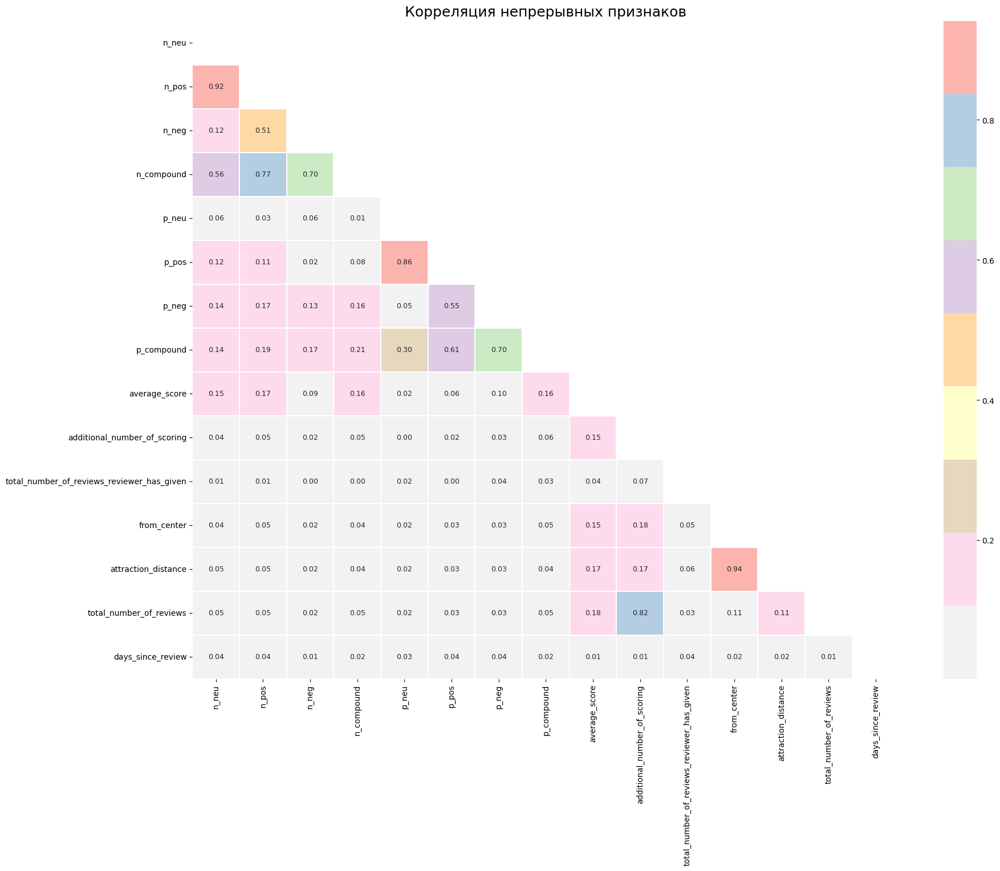

In [117]:
# Смотрим корреляцию непрерывных призанков
build_corr(df_final[df_final['sample']==1], num_cols, 'Корреляция непрерывных признаков', 'pearson')

Мы видим сильно корреляционные признаки > 75, соберем их в единый list

In [118]:
# Список на удаление непрерывных признаков:
cor_drop = ['additional_number_of_scoring', 'n_pos', 'n_neu', 'n_copmpound', 'p_pos', 'from_center']

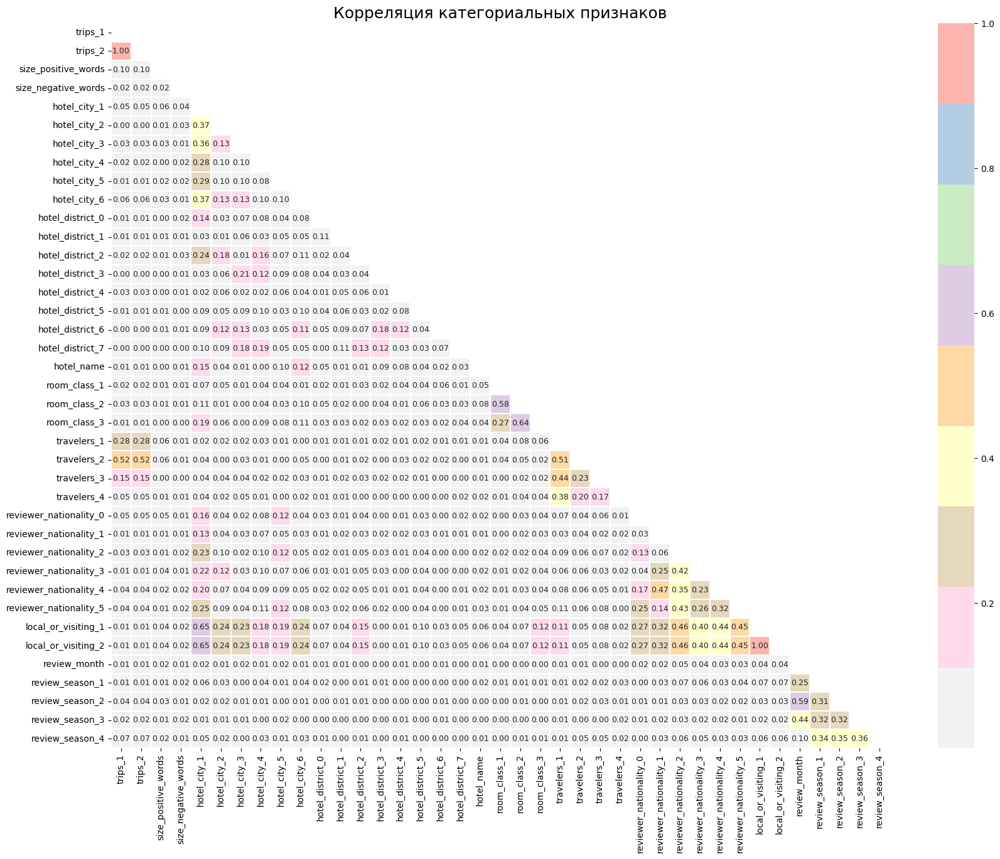

In [119]:
# Смотрим корреляцию категориальных призанков
build_corr(df_final[df_final['sample']==1], cat_cols, 'Корреляция категориальных признаков', 'spearman')

In [120]:
# Список на удаление категориальных признаков:
cor_drop = ['local_or_visiting_2', 'trips_2']

<a id='12'></a>
<p style = "background-color : #fca828; border-radius: 5px 5px; padding : 15px"><strong>

# 12. Обучение модели:

<p style = "background-color : #fca828; border-radius: 5px 5px; padding : 15px"><strong>


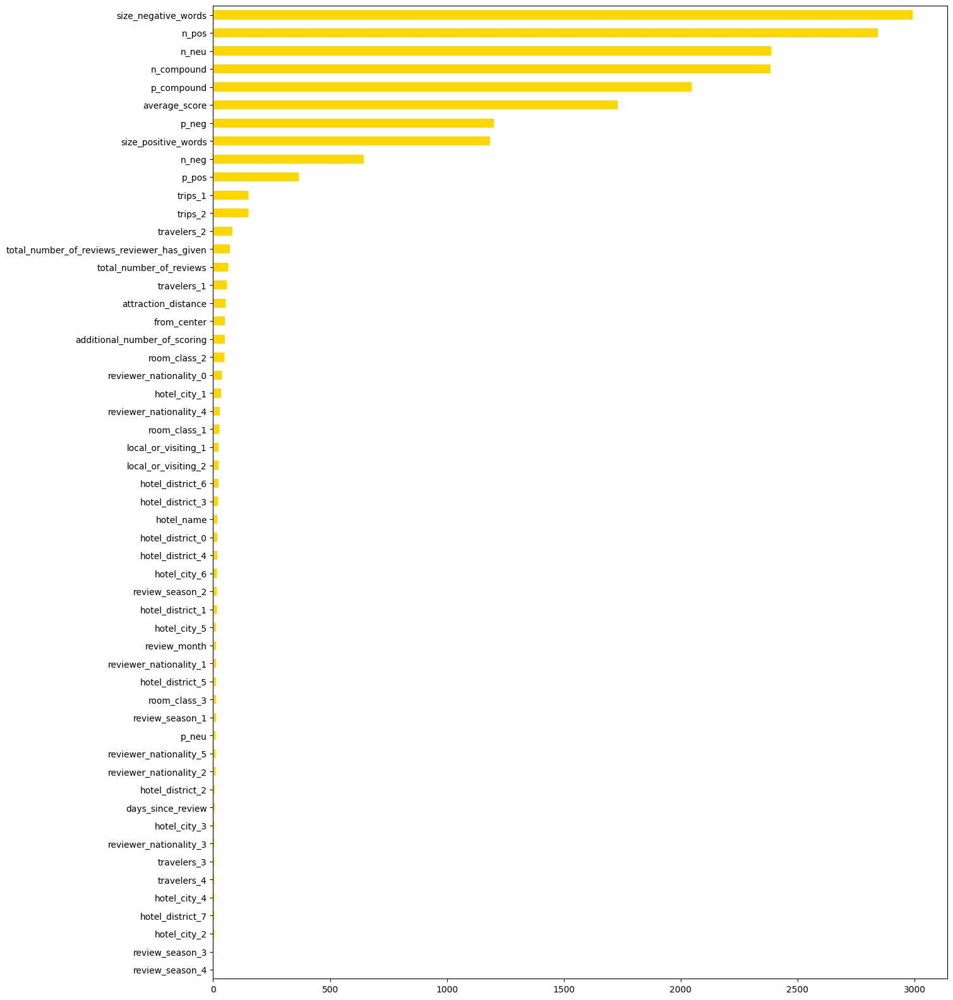

In [121]:
# Оценку значимости признаков выполним дисперсионным анализом Anova:
y = df_final.query('sample == 1').drop(['sample'], axis=1).reviewer_score.values
X = df_final.query('sample == 1').drop(['sample', 'reviewer_score'], axis=1)

# визуализируем результат анализа значимости:
imp_nc = pd.Series(f_classif(X[X.columns], y)[0], index = X.columns)
imp_nc.sort_values(inplace = True)

fig, ax = plt.subplots(figsize=(15, 20))
imp_nc.plot(kind = 'barh', color='gold');



т.е. те признаки, которые мы добавили в `cor_drop` являются значимыми. Может быть они как-то взаимозаменяются или учитываются, поэтому пожалуй оставлю их. А удалю те, которые не влияют на оценку, это `review_season_3` и `review_season_4`

In [122]:
drop_row = ['review_season_3', 'review_season_4']
df_final.drop(drop_row, axis = 1, inplace = True)

In [123]:
# Удалим дубликаты, которые ранее не удаляли:
train_data = df_final.query('sample == 1').drop(['sample'], axis=1).drop_duplicates()

test_data = df_final.query('sample == 0').drop(['sample'], axis=1)

# Разбиваем датафрейм на части, необходимые для обучения и тестирования модели  
# Х — данные с информацией об отелях, у — целевая переменная (рейтинги отелей)
y = train_data.reviewer_score.values            # наш таргет
X = train_data.drop(['reviewer_score'], axis=1)

# Наборы данных с меткой "train" будут использоваться для обучения модели, "test" — для тестирования.  
# Для тестирования мы будем использовать 25 % от исходного датасета.  
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=RANDOM_STATE)

# проверяем размеры:
test_data.shape, train_data.shape, X.shape, X_train.shape, X_test.shape

((128935, 53), (386466, 53), (386466, 52), (309172, 52), (77294, 52))

In [124]:
model = RandomForestRegressor(
    n_estimators=100, 
    verbose=1, 
    n_jobs=-1, 
    random_state=RANDOM_STATE)

In [125]:
%%time

# Обучаем модель на тестовом наборе данных 
model.fit(X_train, y_train)

# Используем обученную модель для предсказания рейтинга отелей в тестовой выборке.  
# Предсказанные значения записываем в переменную y_pred  
y_pred = model.predict(X_test)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 20 concurrent workers.


[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:   22.3s
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  2.0min finished
[Parallel(n_jobs=20)]: Using backend ThreadingBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done  10 tasks      | elapsed:    0.0s


CPU times: total: 33min 34s
Wall time: 2min


[Parallel(n_jobs=20)]: Done 100 out of 100 | elapsed:    0.4s finished


In [127]:
# Сравниваем предсказанные значения (y_pred) с реальными (y_test) и смотрим, насколько они отличаются  
# Метрика называется Mean Absolute Percentage Error (MAPE) и показывает среднюю абсолютную процентную ошибку предсказанных значений в отношении фактических.  

result_mape = round(metrics.mean_absolute_percentage_error(y_test, y_pred) * 100, 4)
print(colored(f'Результат MAPE: {result_mape}','red'))

Результат MAPE: 12.5068


<Axes: >

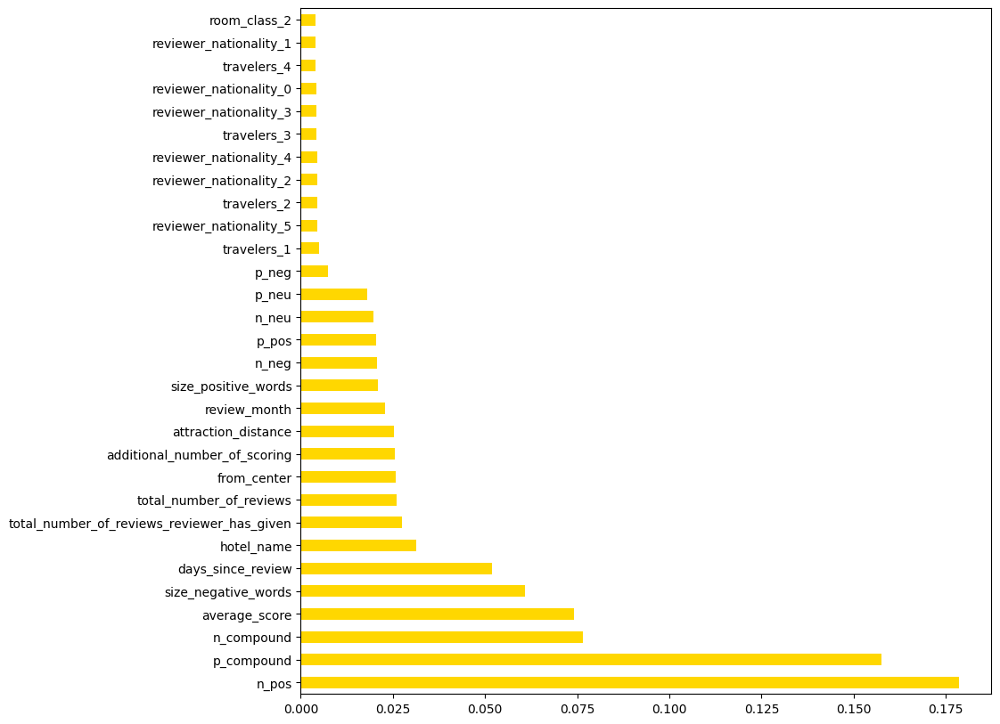

In [128]:
# в RandomForestRegressor есть возможность вывести самые важные признаки для модели
plt.rcParams['figure.figsize'] = (10,10)
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(30).plot(kind='barh', color='gold')

т.е. Чтобы улучшить модель, можно обратить внимание на данные признаки и проработать их более детально. Но я этого конечно делать не буду, считаю, что в качестве выполнения проекта в рамках обучения данного модуля полученных результатов достаточно для того, чтобы двигаться дальше.

In [129]:
test_data.sample(10)

,additional_number_of_scoring,average_score,hotel_name,total_number_of_reviews,total_number_of_reviews_reviewer_has_given,reviewer_score,days_since_review,from_center,attraction_distance,review_month,...,hotel_city_5,hotel_city_6,hotel_district_0,hotel_district_1,hotel_district_2,hotel_district_3,hotel_district_4,hotel_district_5,hotel_district_6,hotel_district_7
422293,-0.183299,8.8,90,0.625204,2.285714,0.0,1.031250,4.546,39.021882,8,...,1,0,1,0,0,0,1,0,0,1
510591,1.460285,7.7,1377,0.915987,-0.285714,0.0,0.375000,3.768,45.946037,4,...,0,0,0,0,0,0,1,1,1,1
494522,-0.517312,9.0,1318,-0.725530,1.000000,0.0,-0.636364,2.492,34.362014,3,...,0,0,0,1,0,1,0,1,1,0
461904,0.606925,9.2,61,0.197798,0.428571,0.0,0.272727,1.499,19.783548,5,...,0,0,0,1,1,0,1,1,1,1
415014,-0.574338,8.4,984,-0.630098,-0.285714,0.0,-0.863636,4.199,50.481181,6,...,0,0,1,0,1,1,1,1,1,1
441381,-0.397149,7.6,891,-0.537113,1.857143,0.0,-0.406250,0.636,20.155098,1,...,0,0,0,0,0,0,0,0,0,1
454413,0.596741,7.9,1074,0.787520,1.000000,0.0,-0.451705,3.235,40.634039,1,...,0,0,0,0,0,0,1,1,1,1
406218,-0.329939,8.8,1048,-0.360114,0.714286,0.0,-0.911932,0.767,31.626282,7,...,0,0,0,0,0,1,1,1,0,0
391573,4.647658,8.7,1146,4.088091,1.285714,0.0,-0.417614,1.052,17.618924,1,...,0,0,0,0,0,1,0,0,0,1
413962,3.965377,8.1,1290,3.031811,-0.285714,0.0,-0.261364,0.635,17.770318,11,...,0,0,0,1,1,1,0,1,1,0


In [130]:
# test_data = test_data.drop(['reviewer_score'], axis=1)

In [ ]:
# sample_submission

NameError: name 'sample_submission' is not defined

In [ ]:
# predict_submission = model.predict(test_data)

In [ ]:
# predict_submission

In [ ]:
# list(sample_submission)

In [ ]:
# sample_submission['reviewer_score'] = predict_submission
# sample_submission.to_csv('submission.csv', index=False)
# sample_submission.head(10)

<a id='13'></a>
<p style = "background-color : #fca828; border-radius: 5px 5px; padding : 15px"><strong>

# 13. Выводы:

<p style = "background-color : #fca828; border-radius: 5px 5px; padding : 15px"><strong>


Выполнена очистка данных, заполнение пропусков и создание новых признаков. В процессе исследования данных построенны графики и предложены идеи по улучшению результатов метрики MAPE.
Основными признаками, которые влияли на размер MAPE были эмоциональные окраски отзывов, расстояние отелей до достопримечательностей и до центра города, в котором расположен непосредственно отель.
А также, свой вклад в результат метрики внес количественный размер отзывов. Гипотеза о том, что каждый отель является брендом, а это сервис, это визуальные предстваление, это стиль и качество услуг которые у людей, на психологическом уровне, уже заявляют о том, что стоит ставить плюс - потому что это на слуху, это популярно, это маркетинг. В качестве улучшения метрики предлагается более скрупулёзно прорабатывать данные признаки. Добившись более качественного, точного определения мы выведем модель на уровень выше.
В качестве начинающего DS от себя могу сказать, что это объемный проект и в нём много ещё в чем можно подзависнуть и по разбирать. Работа длилась долго, но я считаю это показатель заинтересованности специалиста порыться в данных, что на мой взгляд является позитивным направлением для дальнейшего изучения выбранного направления. Да, безусловно, необходима золотая середина между качеством и скоростью работы при решении задач, но пока за наше время платим только мы, поэтому пробуем как можно больше урвать и переварить информации.
Изучены новые библиотеки для работы, появилась идея создания функциональных словарей и готовых шаблонов для работы с датасетами, мне кажется каждый специалист потихоньку нарабатывает данные ачивки по упрощению и ускорению работы. Посмотрим, что будет дальше.
Пишите комментарии, критикуйте работу, предлагайте свои идеи по улучшению написания качества кода, по визуальному оформлению ноутбука и т.д. Что там? Ставьте лайки, подписывайтесь на канал, жмите на колокольчик. 

Отдельный привет **kaggle** за то, что при большой загрузке графиков из библиотеки **Plotly** он отказывается их показывать.


<p style = "background-color : #fca828; border-radius: 5px 5px; padding : 15px"><strong>